Project Description
This data is for the purpose of bias correction of next-day maximum and minimum air temperatures forecast of the LDAPS model operated by the Korea Meteorological Administration over Seoul, South Korea. This data consists of summer data from 2013 to 2017. The input data is largely composed of the LDAPS model's next-day forecast data, in-situ maximum and minimum temperatures of present-day, and geographic auxiliary variables. There are two outputs (i.e. next-day maximum and minimum air temperatures) in this data. Hindcast validation was conducted for the period from 2015 to 2017.


In [7]:
import pandas as pd
import numpy as np
import warnings
warnings.filterwarnings('ignore')
import seaborn as sns
import matplotlib.pyplot as plt

In [8]:
df = pd.read_csv("https://raw.githubusercontent.com/dsrscientist/Dataset2/main/temperature.csv")
df

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,30-06-2013,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.000000,0.000000,0.000000,37.6046,126.991,212.3350,2.785000,5992.895996,29.1,21.2
1,2.0,30-06-2013,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.000000,0.000000,0.000000,37.6046,127.032,44.7624,0.514100,5869.312500,30.5,22.5
2,3.0,30-06-2013,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.000000,0.000000,0.000000,37.5776,127.058,33.3068,0.266100,5863.555664,31.1,23.9
3,4.0,30-06-2013,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.000000,0.000000,0.000000,37.6450,127.022,45.7160,2.534800,5856.964844,31.7,24.3
4,5.0,30-06-2013,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.000000,0.000000,0.000000,37.5507,127.135,35.0380,0.505500,5859.552246,31.2,22.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7747,23.0,30-08-2017,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,...,0.000000,0.000000,0.000000,37.5372,126.891,15.5876,0.155400,4443.313965,28.3,18.1
7748,24.0,30-08-2017,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,...,0.000000,0.000000,0.000000,37.5237,126.909,17.2956,0.222300,4438.373535,28.6,18.8
7749,25.0,30-08-2017,23.2,17.4,22.933014,77.243744,27.939516,18.522965,7.289264,9.090034,...,0.000000,0.000000,0.000000,37.5237,126.970,19.5844,0.271300,4451.345215,27.8,17.4
7750,NaN,NaN,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,...,0.000000,0.000000,0.000000,37.4562,126.826,12.3700,0.098475,4329.520508,17.4,11.3


In [9]:
df.shape

(7752, 25)

The dataset Contains 7752 rows and 25 columns where 23 are independent variables and 2 is target variable(Next_Tmax,Next_Tmin)

In [10]:
df.dtypes

station             float64
Date                 object
Present_Tmax        float64
Present_Tmin        float64
LDAPS_RHmin         float64
LDAPS_RHmax         float64
LDAPS_Tmax_lapse    float64
LDAPS_Tmin_lapse    float64
LDAPS_WS            float64
LDAPS_LH            float64
LDAPS_CC1           float64
LDAPS_CC2           float64
LDAPS_CC3           float64
LDAPS_CC4           float64
LDAPS_PPT1          float64
LDAPS_PPT2          float64
LDAPS_PPT3          float64
LDAPS_PPT4          float64
lat                 float64
lon                 float64
DEM                 float64
Slope               float64
Solar radiation     float64
Next_Tmax           float64
Next_Tmin           float64
dtype: object

This dataset contains two types of data:float64 and object

In [11]:
df.isnull().sum()

station              2
Date                 2
Present_Tmax        70
Present_Tmin        70
LDAPS_RHmin         75
LDAPS_RHmax         75
LDAPS_Tmax_lapse    75
LDAPS_Tmin_lapse    75
LDAPS_WS            75
LDAPS_LH            75
LDAPS_CC1           75
LDAPS_CC2           75
LDAPS_CC3           75
LDAPS_CC4           75
LDAPS_PPT1          75
LDAPS_PPT2          75
LDAPS_PPT3          75
LDAPS_PPT4          75
lat                  0
lon                  0
DEM                  0
Slope                0
Solar radiation      0
Next_Tmax           27
Next_Tmin           27
dtype: int64

In [12]:
df.duplicated().sum()

0

Dropping all null values

In [13]:
df=df.dropna()
df

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,30-06-2013,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.0,0.0,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2
1,2.0,30-06-2013,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.0,0.0,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5
2,3.0,30-06-2013,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.0,0.0,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9
3,4.0,30-06-2013,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.0,0.0,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3
4,5.0,30-06-2013,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.0,0.0,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7745,21.0,30-08-2017,23.1,17.8,24.688997,78.261383,27.812697,18.303014,6.603253,9.614074,...,0.0,0.0,0.0,37.5507,127.040,26.2980,0.5721,4456.024414,27.6,17.7
7746,22.0,30-08-2017,22.5,17.4,30.094858,83.690018,26.704905,17.814038,5.768083,82.146707,...,0.0,0.0,0.0,37.5102,127.086,21.9668,0.1332,4441.803711,28.0,17.1
7747,23.0,30-08-2017,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,...,0.0,0.0,0.0,37.5372,126.891,15.5876,0.1554,4443.313965,28.3,18.1
7748,24.0,30-08-2017,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,...,0.0,0.0,0.0,37.5237,126.909,17.2956,0.2223,4438.373535,28.6,18.8


In [14]:
df.shape

(7588, 25)

Now the dataset contains 7588 rows and 25 columns

In [15]:
df.isnull().sum()

station             0
Date                0
Present_Tmax        0
Present_Tmin        0
LDAPS_RHmin         0
LDAPS_RHmax         0
LDAPS_Tmax_lapse    0
LDAPS_Tmin_lapse    0
LDAPS_WS            0
LDAPS_LH            0
LDAPS_CC1           0
LDAPS_CC2           0
LDAPS_CC3           0
LDAPS_CC4           0
LDAPS_PPT1          0
LDAPS_PPT2          0
LDAPS_PPT3          0
LDAPS_PPT4          0
lat                 0
lon                 0
DEM                 0
Slope               0
Solar radiation     0
Next_Tmax           0
Next_Tmin           0
dtype: int64

Now we can see that there are no null values present in our dataset lets check by heatmap as well

<Axes: >

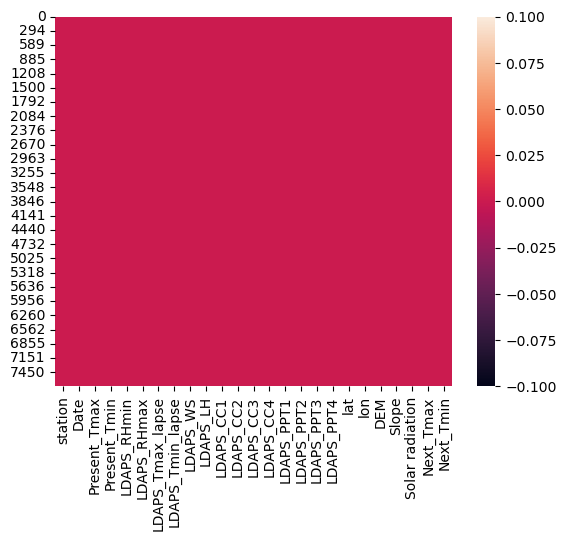

In [16]:
sns.heatmap(df.isnull())

It is clear from the above heatmap that there is no missing data present in our dataset

In [17]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7588 entries, 0 to 7749
Data columns (total 25 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   station           7588 non-null   float64
 1   Date              7588 non-null   object 
 2   Present_Tmax      7588 non-null   float64
 3   Present_Tmin      7588 non-null   float64
 4   LDAPS_RHmin       7588 non-null   float64
 5   LDAPS_RHmax       7588 non-null   float64
 6   LDAPS_Tmax_lapse  7588 non-null   float64
 7   LDAPS_Tmin_lapse  7588 non-null   float64
 8   LDAPS_WS          7588 non-null   float64
 9   LDAPS_LH          7588 non-null   float64
 10  LDAPS_CC1         7588 non-null   float64
 11  LDAPS_CC2         7588 non-null   float64
 12  LDAPS_CC3         7588 non-null   float64
 13  LDAPS_CC4         7588 non-null   float64
 14  LDAPS_PPT1        7588 non-null   float64
 15  LDAPS_PPT2        7588 non-null   float64
 16  LDAPS_PPT3        7588 non-null   float64


In [18]:
import datetime as ddt
df['Date'] = pd.to_datetime(df['Date'])
df['Date'] = df['Date'].map(ddt.datetime.toordinal)

In [19]:
df.isnull().sum()

station             0
Date                0
Present_Tmax        0
Present_Tmin        0
LDAPS_RHmin         0
LDAPS_RHmax         0
LDAPS_Tmax_lapse    0
LDAPS_Tmin_lapse    0
LDAPS_WS            0
LDAPS_LH            0
LDAPS_CC1           0
LDAPS_CC2           0
LDAPS_CC3           0
LDAPS_CC4           0
LDAPS_PPT1          0
LDAPS_PPT2          0
LDAPS_PPT3          0
LDAPS_PPT4          0
lat                 0
lon                 0
DEM                 0
Slope               0
Solar radiation     0
Next_Tmax           0
Next_Tmin           0
dtype: int64

In [20]:
df.describe()

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
count,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,...,7588.000000,7588.000000,7588.000000,7588.000000,7588.00000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000
mean,13.014101,735795.210727,29.748366,23.195809,56.724969,88.360823,29.620128,23.511786,7.094097,62.492606,...,0.480738,0.275007,0.265373,37.544792,126.99142,61.918136,1.259755,5343.724208,30.241526,22.910820
std,7.217858,520.426996,2.967401,2.400880,14.626559,7.199456,2.943496,2.342579,2.177034,33.686158,...,1.743327,1.146087,1.179661,0.050428,0.07922,54.323529,1.372748,429.782561,3.111807,2.482256
min,1.000000,734875.000000,20.000000,11.300000,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,...,0.000000,0.000000,0.000000,37.456200,126.82600,12.370000,0.098500,4329.520508,17.400000,11.300000
25%,7.000000,735427.000000,27.800000,21.600000,45.960243,84.203724,27.673756,22.086820,5.675358,37.206201,...,0.000000,0.000000,0.000000,37.510200,126.93700,28.700000,0.271300,5001.485717,28.200000,21.300000
50%,13.000000,735806.000000,29.900000,23.400000,55.023199,89.784122,29.709537,23.758249,6.547838,56.898324,...,0.000000,0.000000,0.000000,37.550700,126.99500,45.716000,0.618000,5441.987305,30.400000,23.100000
75%,19.000000,736199.000000,32.000000,24.800000,67.115099,93.742725,31.711109,25.155660,8.028960,84.235666,...,0.017735,0.007855,0.000017,37.577600,127.04200,59.832400,1.767800,5729.485840,32.600000,24.600000
max,25.000000,736671.000000,37.600000,29.900000,98.524734,100.000153,38.542255,29.619342,21.857621,213.414006,...,21.621661,15.841235,16.655469,37.645000,127.13500,212.335000,5.178200,5992.895996,38.900000,29.800000


From the above we observe that:
1.The counts of all the columns is same which means there are no missing values in the dataset
2.In few column the mean value is greater than the median(50%) which means the data is skewed to right in these columns
3.In few columns the mean vlaue is less than the median(50%) which means the data is skewed to left in these columns.
4.There is huge difference between 75% and max hence there are outliers present in the data which we will remove them later on using appropriate methods.

Univarient Analysis

25.0    307
10.0    307
23.0    307
18.0    307
17.0    307
2.0     307
3.0     306
4.0     306
13.0    305
16.0    304
20.0    304
21.0    304
14.0    303
1.0     303
9.0     302
12.0    302
15.0    302
19.0    302
22.0    302
24.0    302
11.0    301
7.0     301
6.0     301
8.0     300
5.0     296
Name: station, dtype: int64


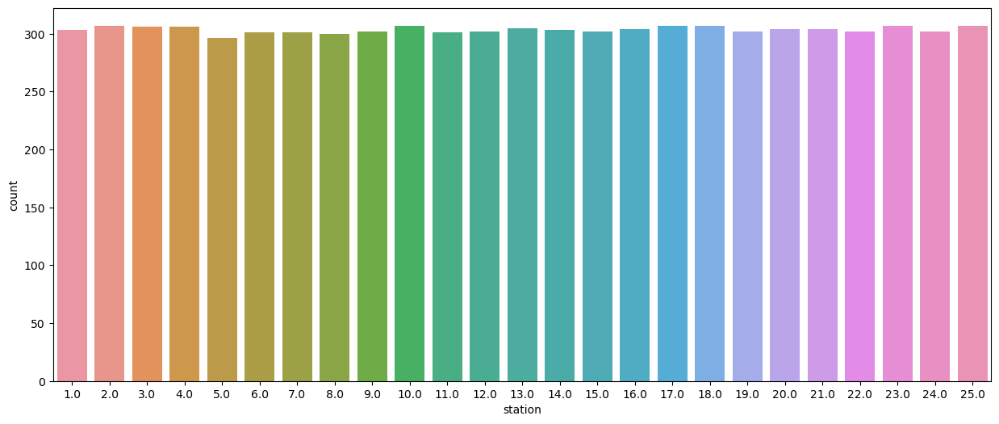

In [184]:
print(df['station'].value_counts())
plt.figure(figsize=(15,6))
sns.countplot(x=df['station'])
plt.show()

 From the above plot it is clear that station number 2,17,18,23,10,25 are most active about temperature information

31.4    112
29.4    108
29.1    106
29.2    105
30.6    105
       ... 
21.2      1
20.1      1
36.4      1
20.3      1
20.0      1
Name: Present_Tmax, Length: 167, dtype: int64


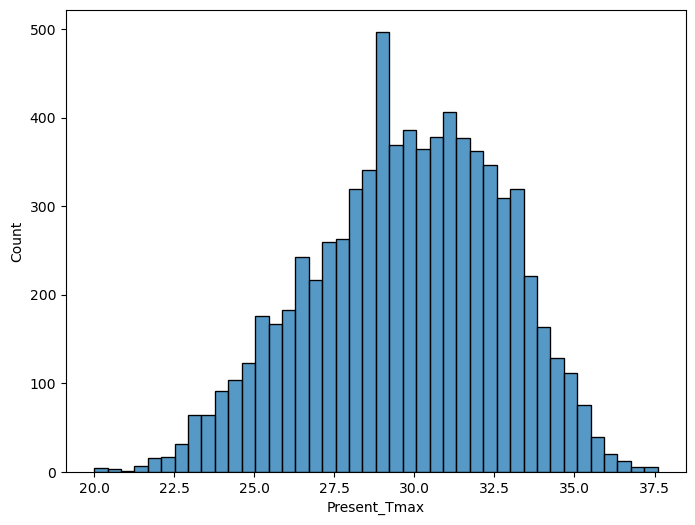

In [23]:
print(df['Present_Tmax'].value_counts())
plt.figure(figsize=(8,6))
sns.histplot(x=df['Present_Tmax'])
plt.show()

From the above plot it is clear that maximum air temperature at present day is around 31.4

24.0    160
23.8    153
23.5    143
23.1    143
23.3    140
       ... 
14.3      1
29.9      1
29.7      1
29.1      1
15.0      1
Name: Present_Tmin, Length: 155, dtype: int64


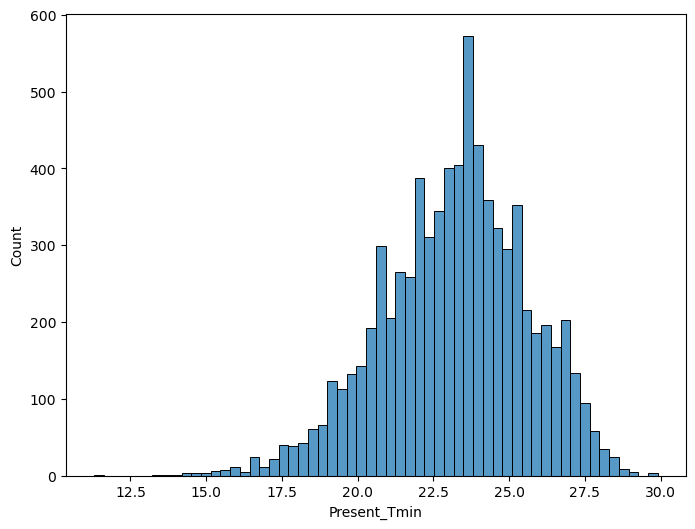

In [25]:
print(df['Present_Tmin'].value_counts())
plt.figure(figsize=(8,6))
sns.histplot(x=df['Present_Tmin'])
plt.show()

From the above plot it is clear that minimum air temperature at present day is around 24

77.030350    2
51.810596    2
71.658089    2
58.255688    1
46.582764    1
            ..
58.950947    1
58.566174    1
59.790348    1
51.062355    1
22.933014    1
Name: LDAPS_RHmin, Length: 7585, dtype: int64


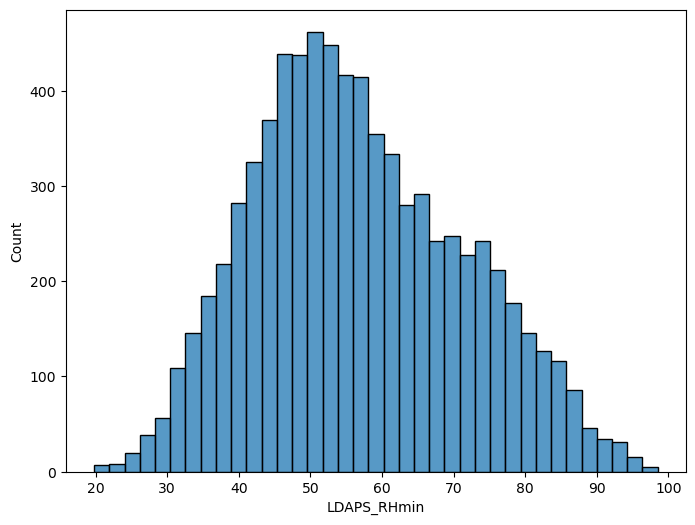

In [186]:
print(df['LDAPS_RHmin'].value_counts())
plt.figure(figsize=(8,6))
sns.histplot(x=df['LDAPS_RHmin'])
plt.show()

From the above plot it is clear that next-day minimum relative humidity (%) is around 77

92.531029    2
88.876610    2
85.863731    2
96.525200    2
96.058418    2
            ..
84.423607    1
81.810715    1
92.785057    1
91.507935    1
77.243744    1
Name: LDAPS_RHmax, Length: 7577, dtype: int64


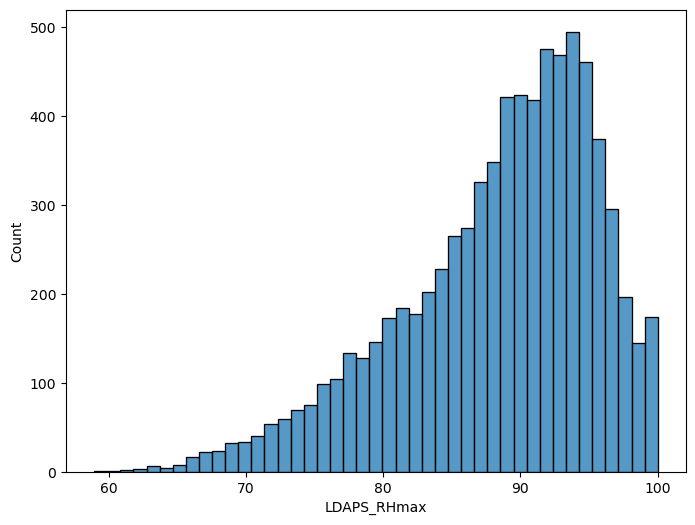

In [188]:
print(df['LDAPS_RHmax'].value_counts())
plt.figure(figsize=(8,6))
sns.histplot(x=df['LDAPS_RHmax'])
plt.show()

From the above plot it is clear that next-day maximum relative humidity % is about 92

28.074101    1
31.134897    1
33.447754    1
32.631448    1
30.795575    1
            ..
27.737869    1
28.321177    1
27.629996    1
28.775293    1
27.939516    1
Name: LDAPS_Tmax_lapse, Length: 7588, dtype: int64


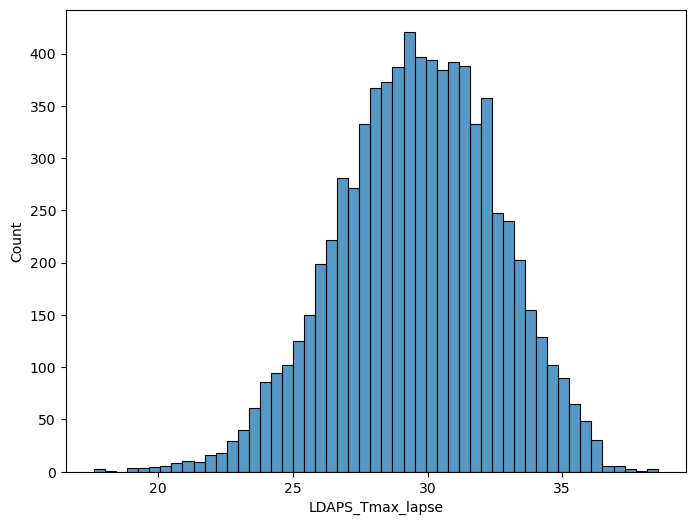

In [28]:
print(df['LDAPS_Tmax_lapse'].value_counts())
plt.figure(figsize=(8,6))
sns.histplot(x=df['LDAPS_Tmax_lapse'])
plt.show()

From the above plot it is clear that next-day maximum air temperature applied lapse rate is around 28

23.006936    1
21.156704    1
24.222358    1
23.736497    1
23.064826    1
            ..
22.034331    1
21.008695    1
21.839880    1
22.247555    1
18.522965    1
Name: LDAPS_Tmin_lapse, Length: 7588, dtype: int64


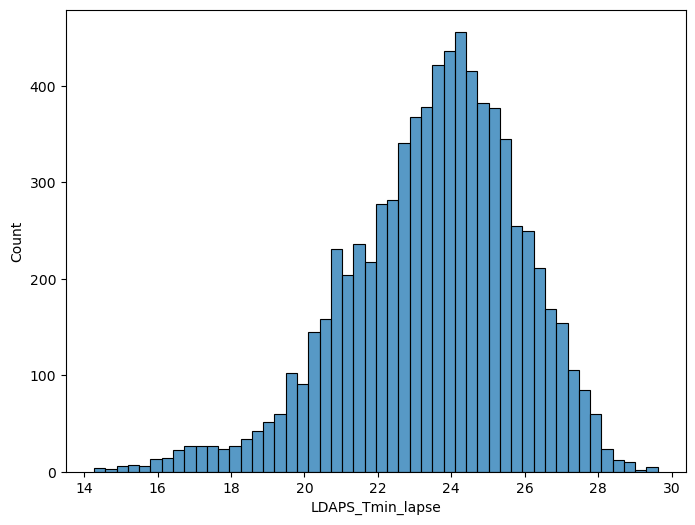

In [190]:
print(df['LDAPS_Tmin_lapse'].value_counts())
plt.figure(figsize=(8,6))
sns.histplot(x=df['LDAPS_Tmin_lapse'])
plt.show()

From the above plot it is clear that next-day minimum air temperature applied lapse rate is around 23

6.818887    1
5.483732    1
6.749639    1
6.404110    1
8.349506    1
           ..
7.595801    1
8.195843    1
7.852853    1
7.991329    1
7.289264    1
Name: LDAPS_WS, Length: 7588, dtype: int64


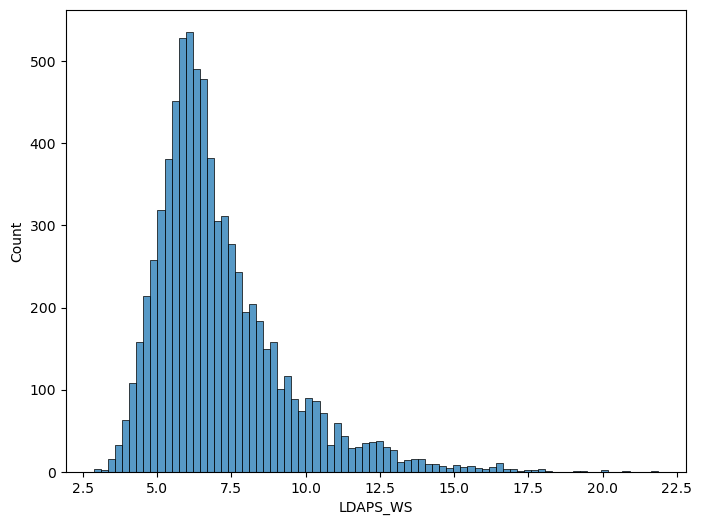

In [31]:
print(df['LDAPS_WS'].value_counts())
plt.figure(figsize=(8,6))
sns.histplot(x=df['LDAPS_WS'])
plt.show()

From the above plot it clear that next-day average wind speed (m/s) is around 6.8

69.451805     1
101.307648    1
16.204221     1
77.699182     1
119.922983    1
             ..
68.288728     1
72.907605     1
65.992804     1
35.616482     1
9.090034      1
Name: LDAPS_LH, Length: 7588, dtype: int64


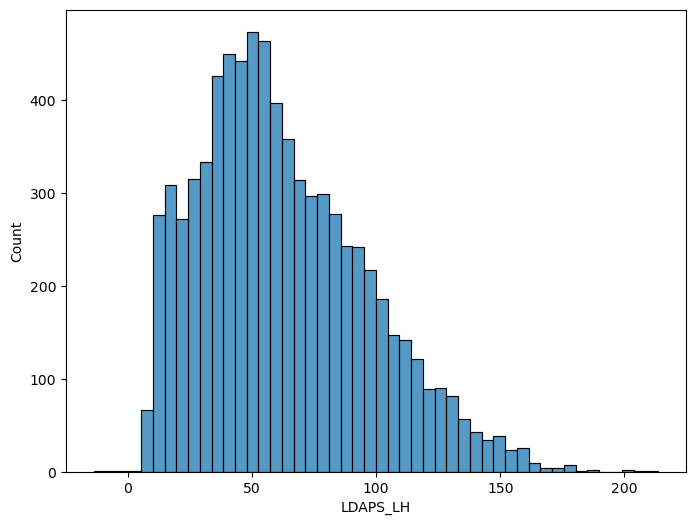

In [32]:
print(df['LDAPS_LH'].value_counts())
plt.figure(figsize=(8,6))
sns.histplot(x=df['LDAPS_LH'])
plt.show()

From the above plot it is clear that next-day average latent heat flux (W/m2) ia around 69

0.000000    104
0.233947      1
0.280824      1
0.347618      1
0.372637      1
           ... 
0.011633      1
0.020428      1
0.021683      1
0.008280      1
0.048954      1
Name: LDAPS_CC1, Length: 7485, dtype: int64


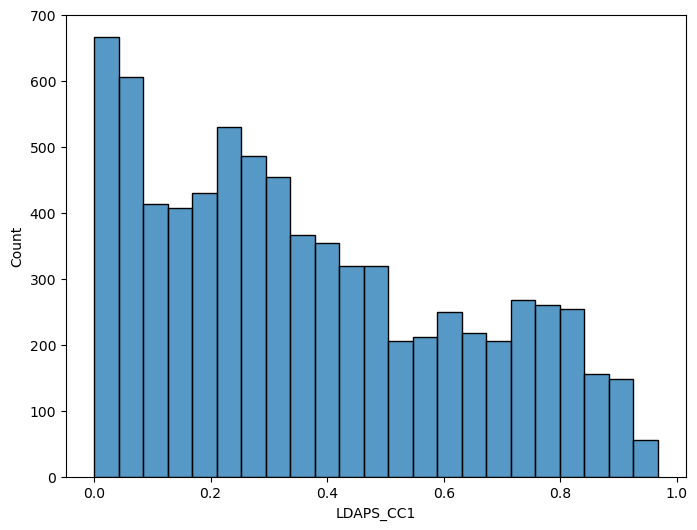

In [34]:
print(df['LDAPS_CC1'].value_counts())
plt.figure(figsize=(8,6))
sns.histplot(x=df['LDAPS_CC1'])
plt.show()

From the above plot it is clear that model forecast of next-day 1st 6-hour split average cloud cover (0-5 h) (%) is almost 100

0.000000    93
0.203896     1
0.196689     1
0.021183     1
0.001433     1
            ..
0.091687     1
0.086090     1
0.102609     1
0.076528     1
0.059869     1
Name: LDAPS_CC2, Length: 7496, dtype: int64


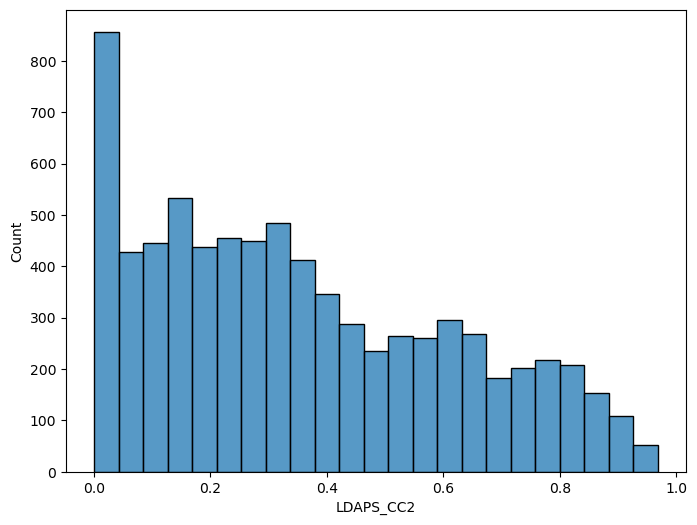

In [35]:
print(df['LDAPS_CC2'].value_counts())
plt.figure(figsize=(8,6))
sns.histplot(x=df['LDAPS_CC2'])
plt.show()

From the above plot we observe that model forecast of next-day 2nd 6-hour split average cloud cover (6-11 h) (%) is around 93

0.000000e+00    75
8.680560e-04     2
5.810000e-07     2
1.616969e-01     1
8.667610e-02     1
                ..
6.616012e-01     1
6.588265e-01     1
5.463407e-01     1
5.650474e-01     1
5.850000e-07     1
Name: LDAPS_CC3, Length: 7512, dtype: int64


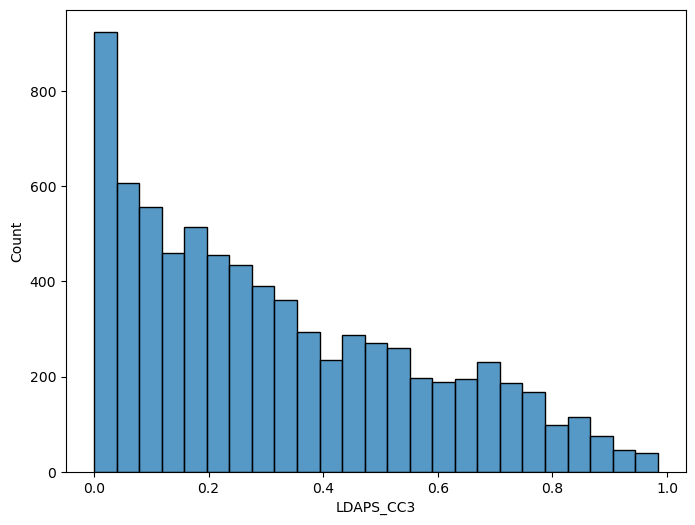

In [36]:
print(df['LDAPS_CC3'].value_counts())
plt.figure(figsize=(8,6))
sns.histplot(x=df['LDAPS_CC3'])
plt.show()

From the above plot it is clear that model forecast of next-day 3rd 6-hour split average cloud cover (12-17 h) (%) is around 75 

0.000000    135
0.002604      7
0.001736      3
0.005208      3
0.373025      2
           ... 
0.048167      1
0.081127      1
0.092123      1
0.124582      1
0.000796      1
Name: LDAPS_CC4, Length: 7438, dtype: int64


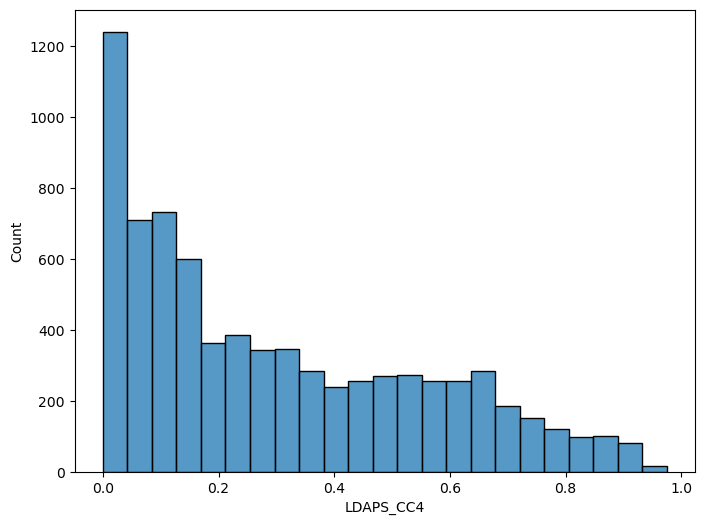

In [37]:
print(df['LDAPS_CC4'].value_counts())
plt.figure(figsize=(8,6))
sns.histplot(x=df['LDAPS_CC4'])
plt.show()

From the above plot we observe that model forecast of next-day 4th 6-hour split average cloud cover (18-23 h) (%) is more than 100

37.5776    1214
37.5507    1204
37.6181     611
37.6046     610
37.5237     609
37.5372     608
37.4967     605
37.4697     604
37.5102     603
37.4562     307
37.4832     307
37.6450     306
Name: lat, dtype: int64


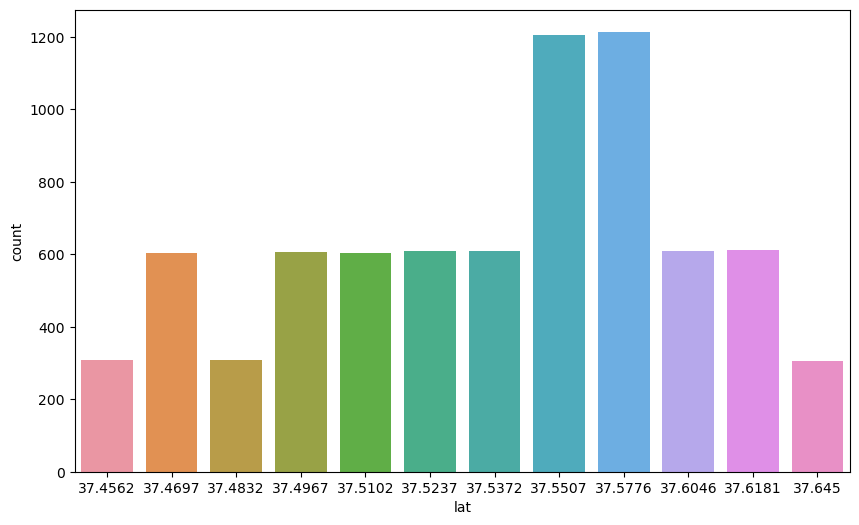

In [44]:
print(df['lat'].value_counts())
plt.figure(figsize=(10,6))
sns.countplot(x=df['lat'])
plt.show()

From the above plot it is clear that latitude is maximum in range 37.5507-37.5776

126.970    307
126.955    307
126.891    307
127.024    307
127.099    307
127.032    307
127.058    306
127.022    306
127.083    305
126.995    304
127.004    304
127.040    304
126.927    303
126.991    303
126.826    302
126.988    302
126.937    302
126.938    302
127.086    302
126.909    302
127.085    301
126.838    301
127.042    301
126.910    300
127.135    296
Name: lon, dtype: int64


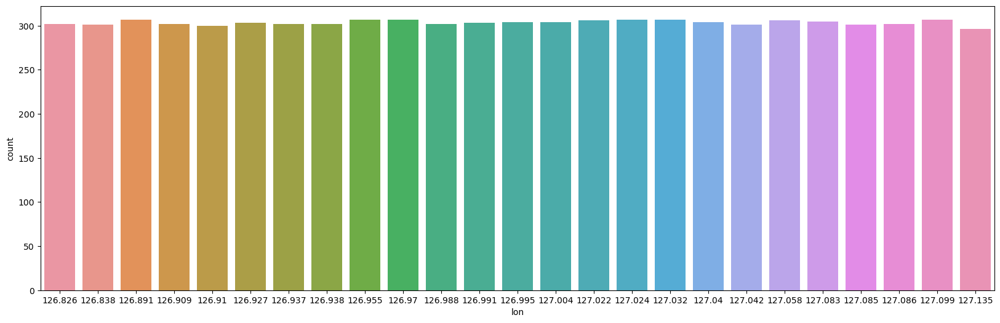

In [47]:
print(df['lon'].value_counts())
plt.figure(figsize=(20,6))
sns.countplot(x=df['lon'])
plt.show()

From the above plot it is clear that longitude is maximum at 126.891,126.955,126.97,127.058,127.083,127.099

19.5844     307
208.5070    307
15.5876     307
56.4448     307
53.4712     307
44.7624     307
33.3068     306
45.7160     306
59.8324     305
82.2912     304
146.5540    304
26.2980     304
30.9680     303
212.3350    303
50.9312     302
132.1180    302
30.0464     302
75.0924     302
21.9668     302
17.2956     302
28.7000     301
12.3700     301
54.6384     301
52.5180     300
35.0380     296
Name: DEM, dtype: int64


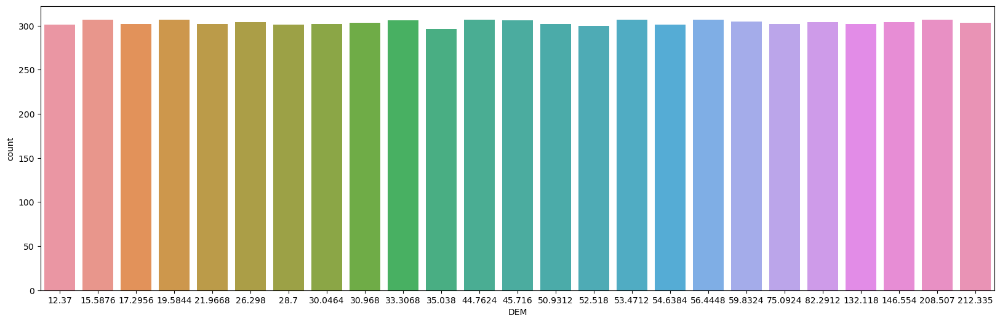

In [49]:
print(df['DEM'].value_counts())
plt.figure(figsize=(20,6))
sns.countplot(x=df['DEM'])
plt.show()

From the above plot it is clear that Elevation is maximum at 53.4712,56.448,208.507

0.2713    307
5.1782    307
0.1554    307
1.2313    307
0.6970    307
0.5141    307
0.2661    306
2.5348    306
2.6865    305
2.2579    304
4.7296    304
0.5721    304
0.6180    303
2.7850    303
0.4125    302
0.5931    302
0.8552    302
1.7678    302
0.1332    302
0.2223    302
0.6233    301
0.0985    301
0.1457    301
1.5629    300
0.5055    296
Name: Slope, dtype: int64


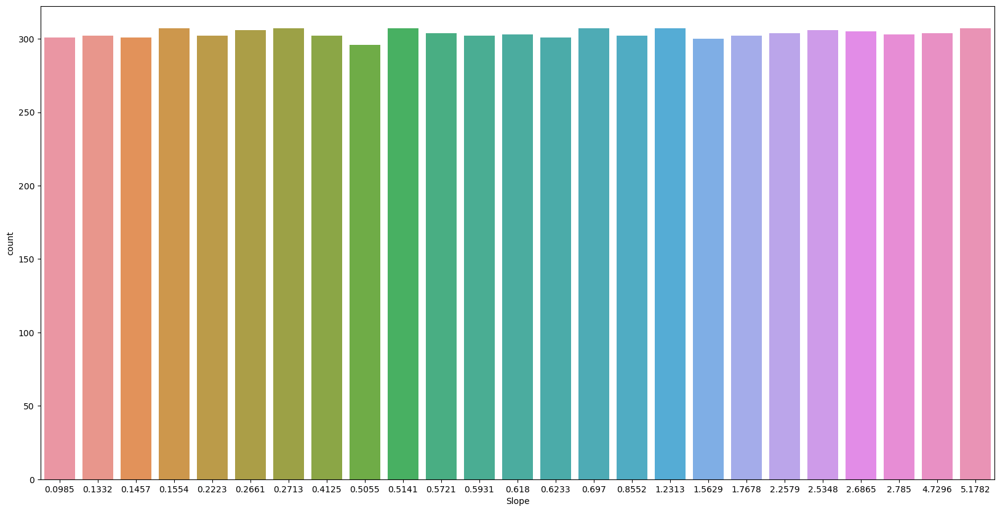

In [52]:
print(df['Slope'].value_counts())
plt.figure(figsize=(20,10))
sns.countplot(x=df['Slope'])
plt.show()

From the above plot it is clear that slope is maximum at 0.697,1.2313

5455.486816    5
5356.832520    5
5209.735352    5
4543.530273    5
5232.047852    5
              ..
4408.542480    1
4418.823730    1
4423.769531    1
4575.028809    1
4411.375977    1
Name: Solar radiation, Length: 1575, dtype: int64


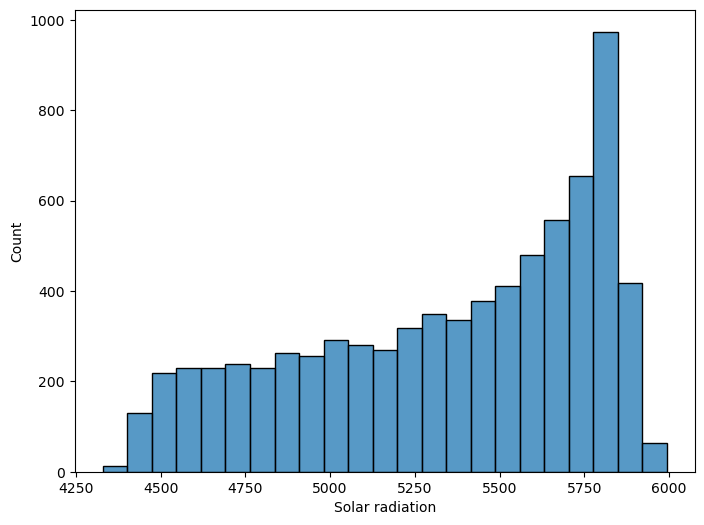

In [54]:
print(df['Solar radiation'].value_counts())
plt.figure(figsize=(8,6))
sns.histplot(x=df['Solar radiation'])
plt.show()

From the above plot it is clear that Daily incoming solar radiation (wh/m2) are around 5800

29.3    113
33.0    104
31.3    100
29.6     98
31.2     97
       ... 
37.5      1
38.7      1
37.4      1
20.9      1
17.4      1
Name: Next_Tmax, Length: 181, dtype: int64


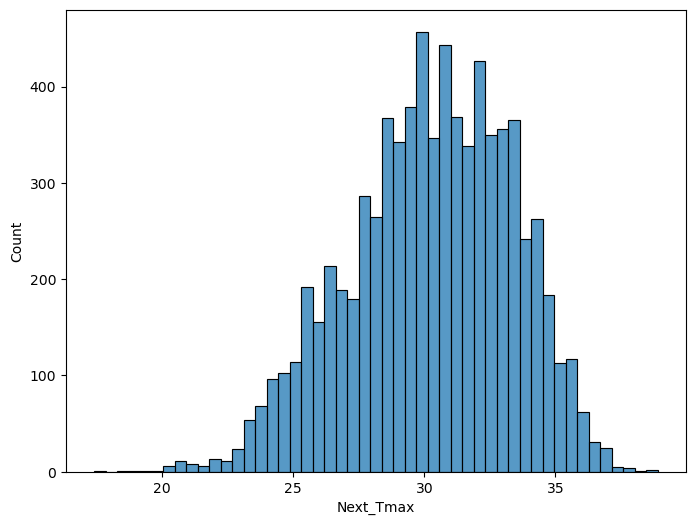

In [56]:
print(df['Next_Tmax'].value_counts())
plt.figure(figsize=(8,6))
sns.histplot(x=df['Next_Tmax'])
plt.show()

From the above plot it is clear that next-day maximum air temperature is maximum around 29-32

23.5    157
24.0    152
23.4    150
23.2    148
23.8    146
       ... 
29.8      1
28.5      1
29.1      1
29.4      1
12.9      1
Name: Next_Tmin, Length: 157, dtype: int64


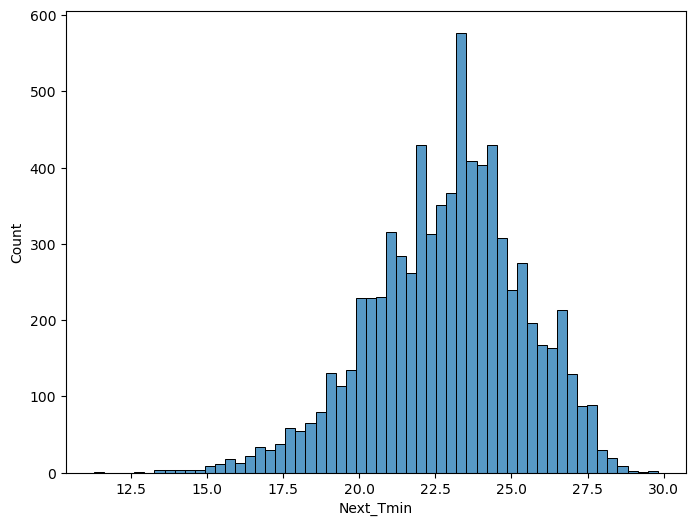

In [58]:
print(df['Next_Tmin'].value_counts())
plt.figure(figsize=(8,6))
sns.histplot(x=df['Next_Tmin'])
plt.show()

From the above plot it is clear that next-day minimum air temperature is around 23-25

BiVarient Analysis with Next_Tmax

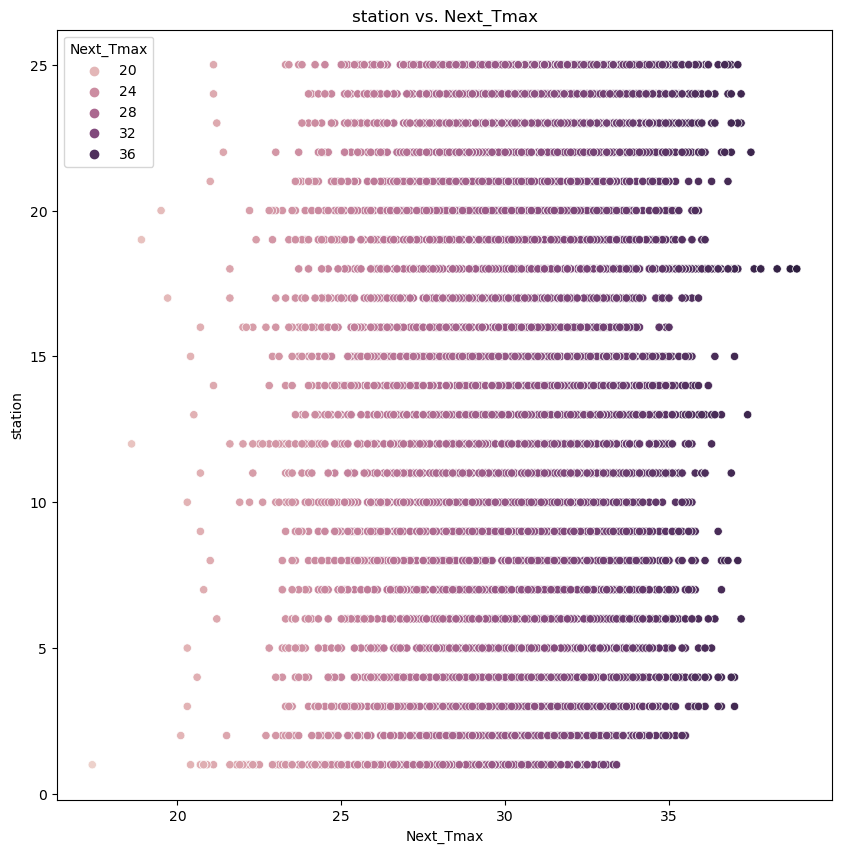

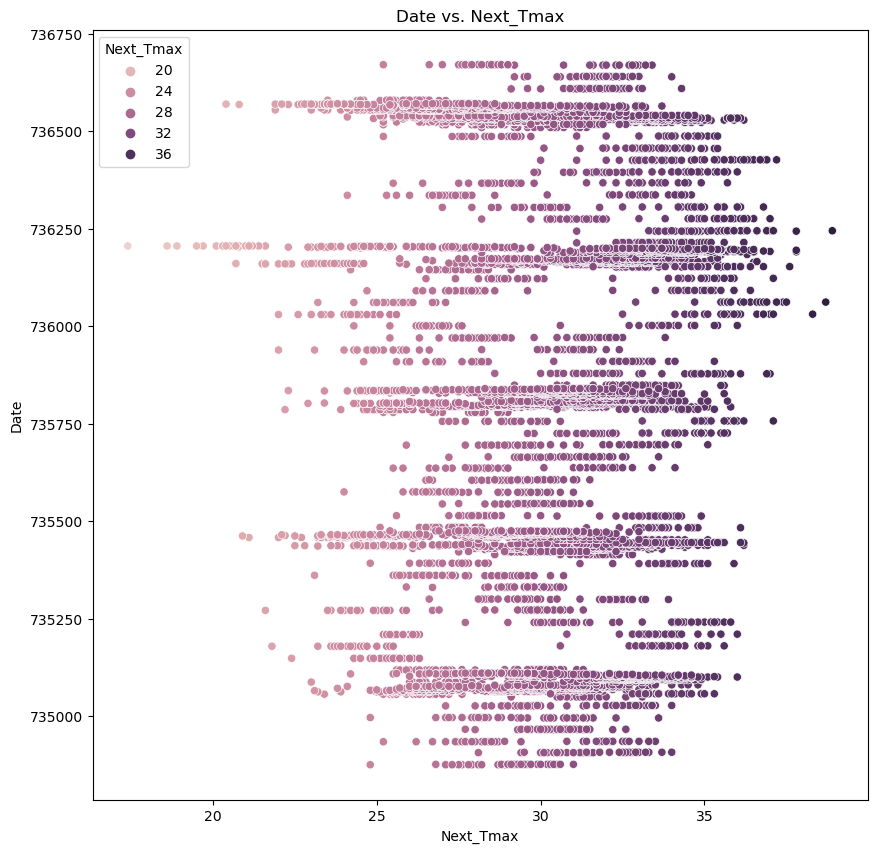

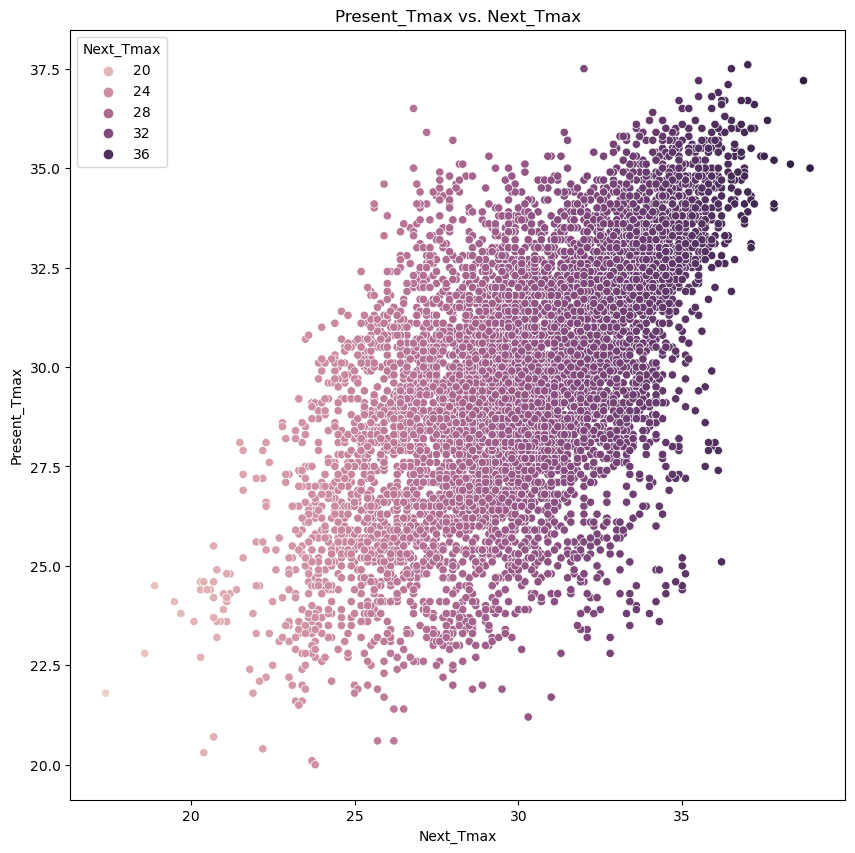

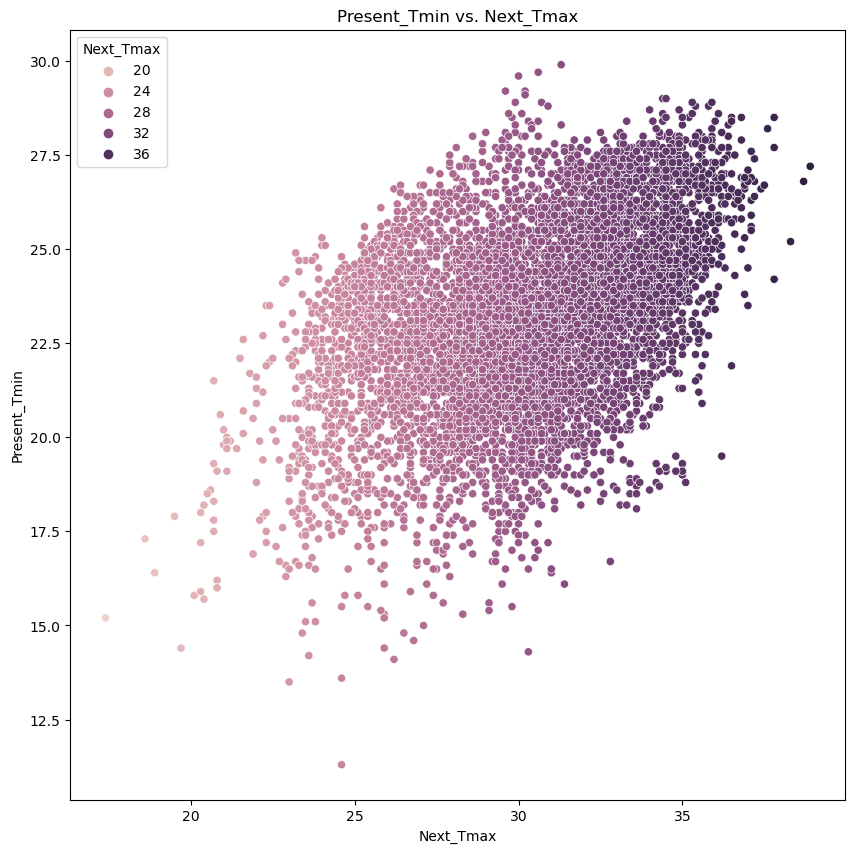

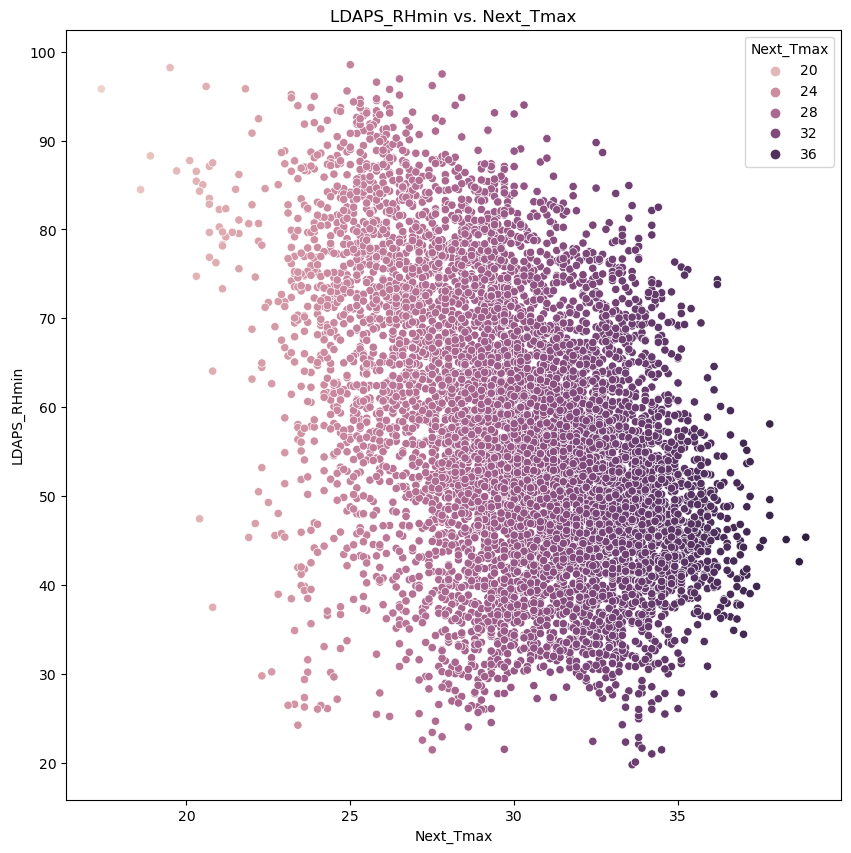

...

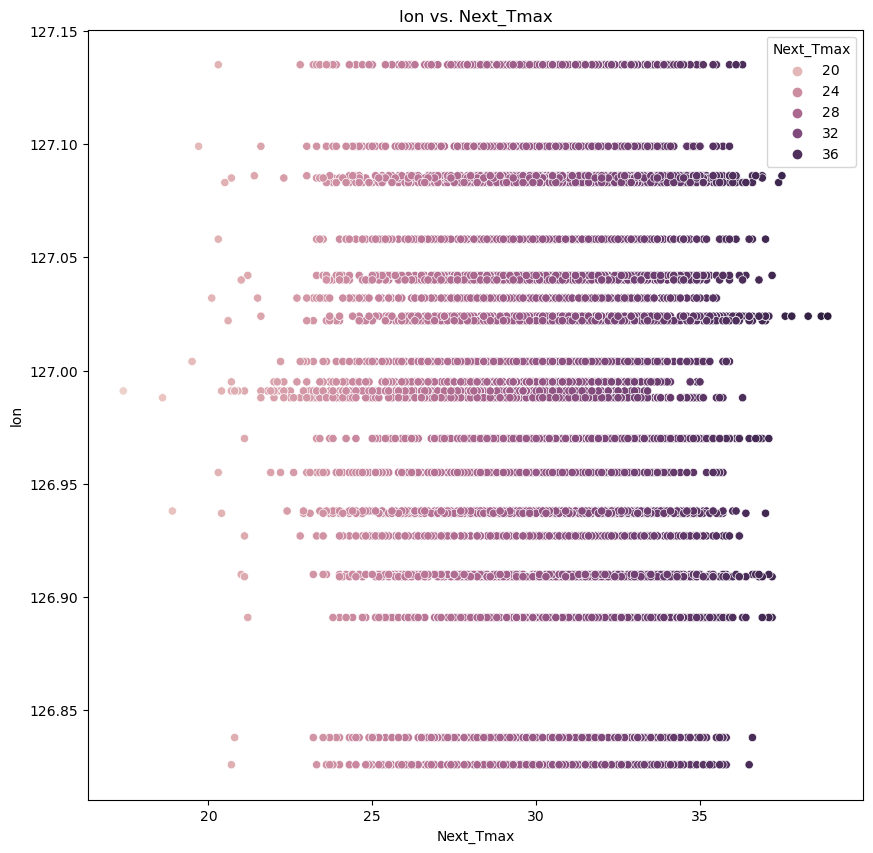

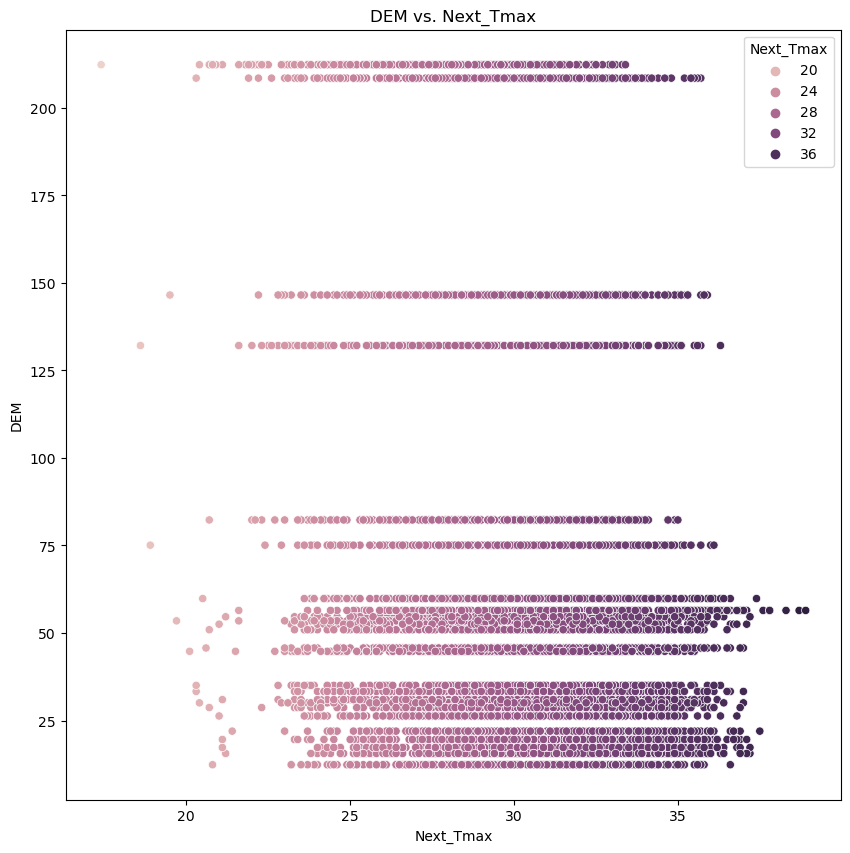

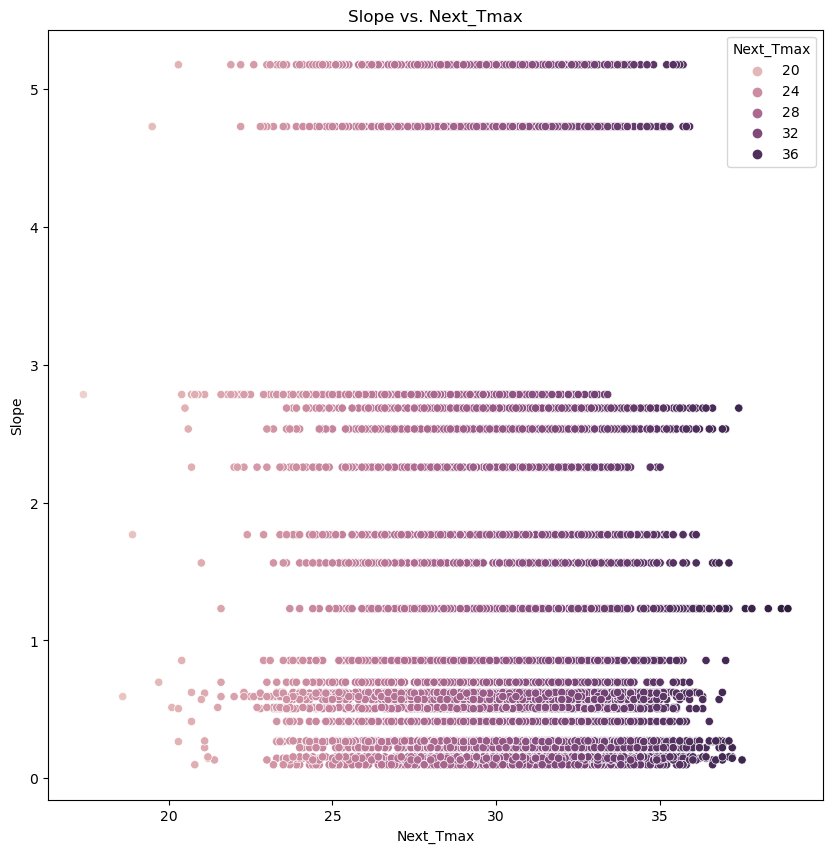

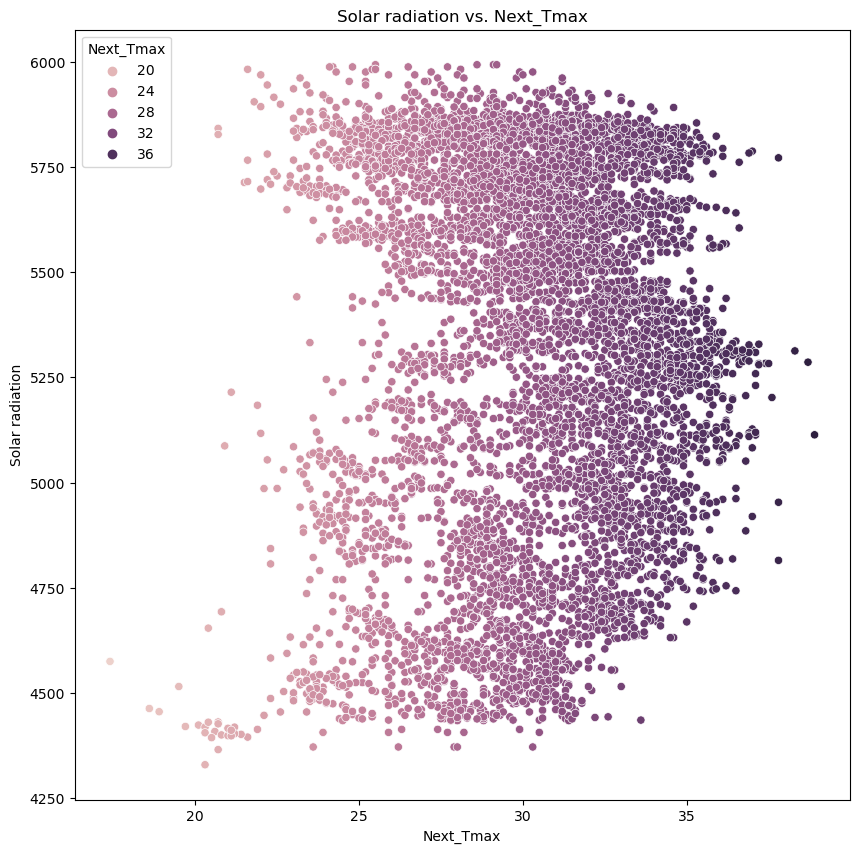

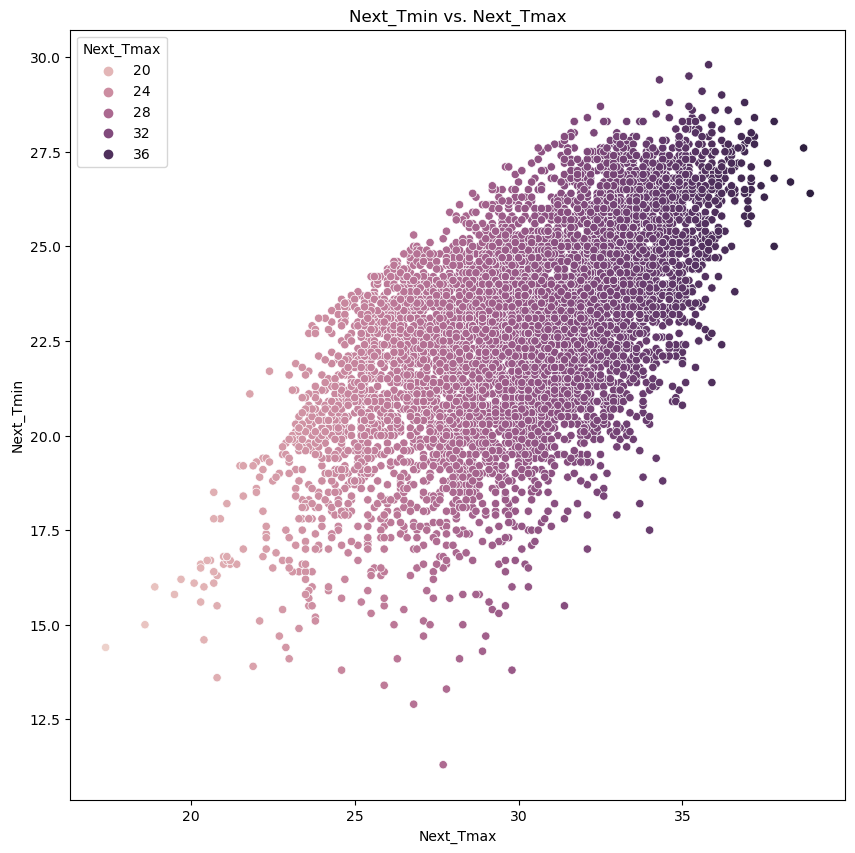

In [69]:
for col in df.drop(['Next_Tmax'],axis=1):
    plt.figure(figsize=(10,10))
    plt.title(f'{col} vs. Next_Tmax')
    sns.scatterplot(y=df[col],x=df['Next_Tmax'],hue=df['Next_Tmax'])
    plt.show()

BiVarient Analysis with Next_Tmin

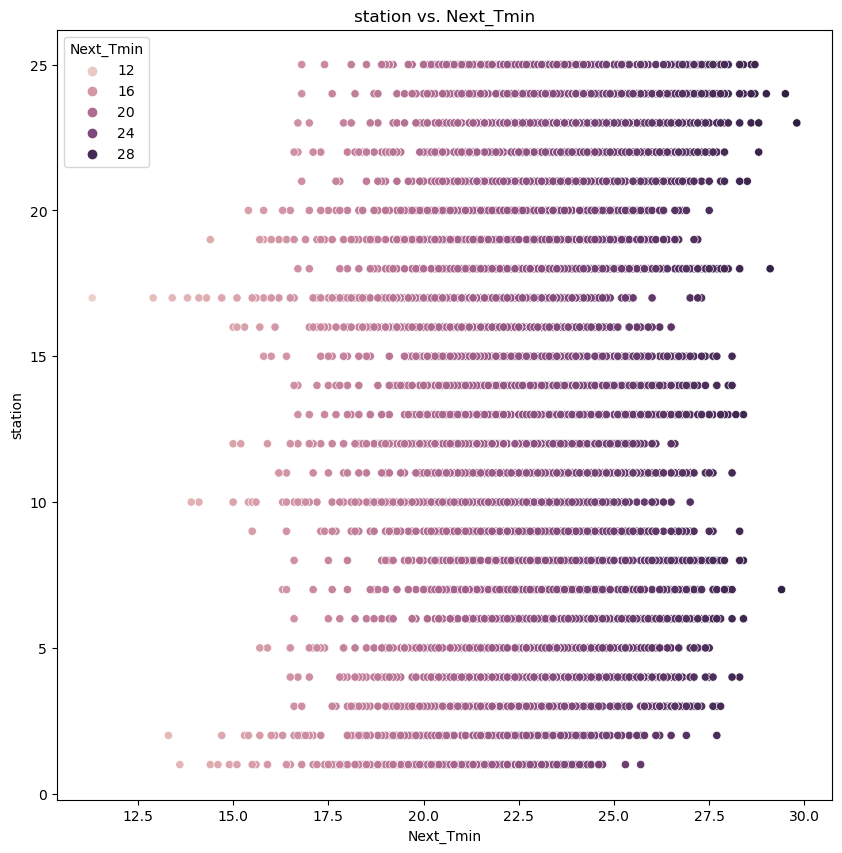

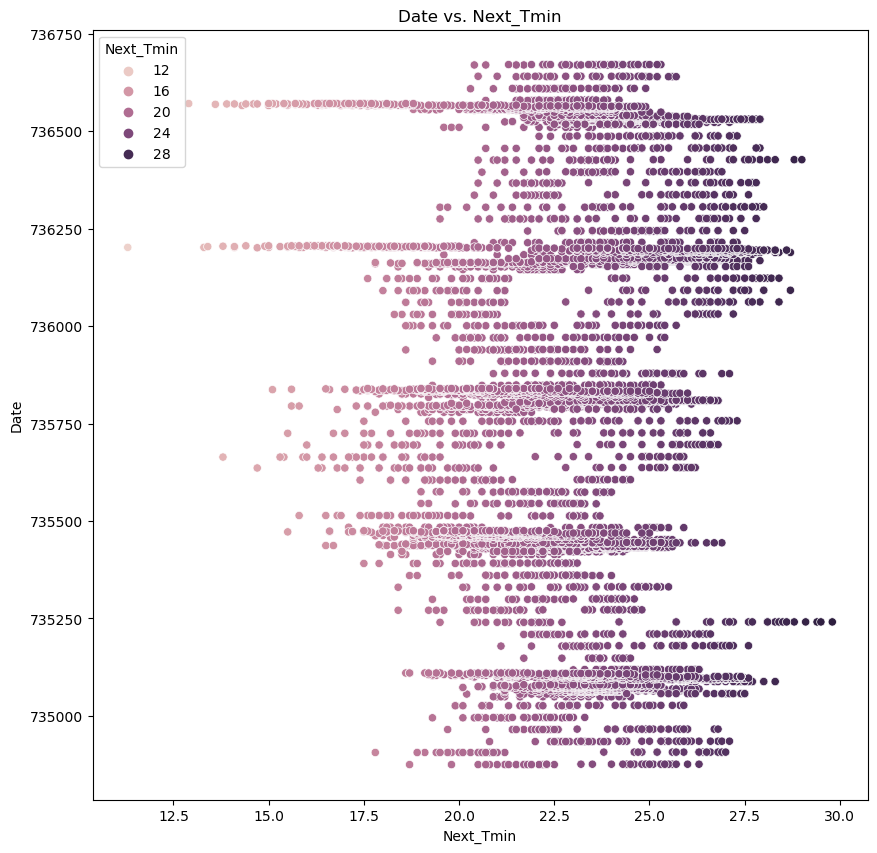

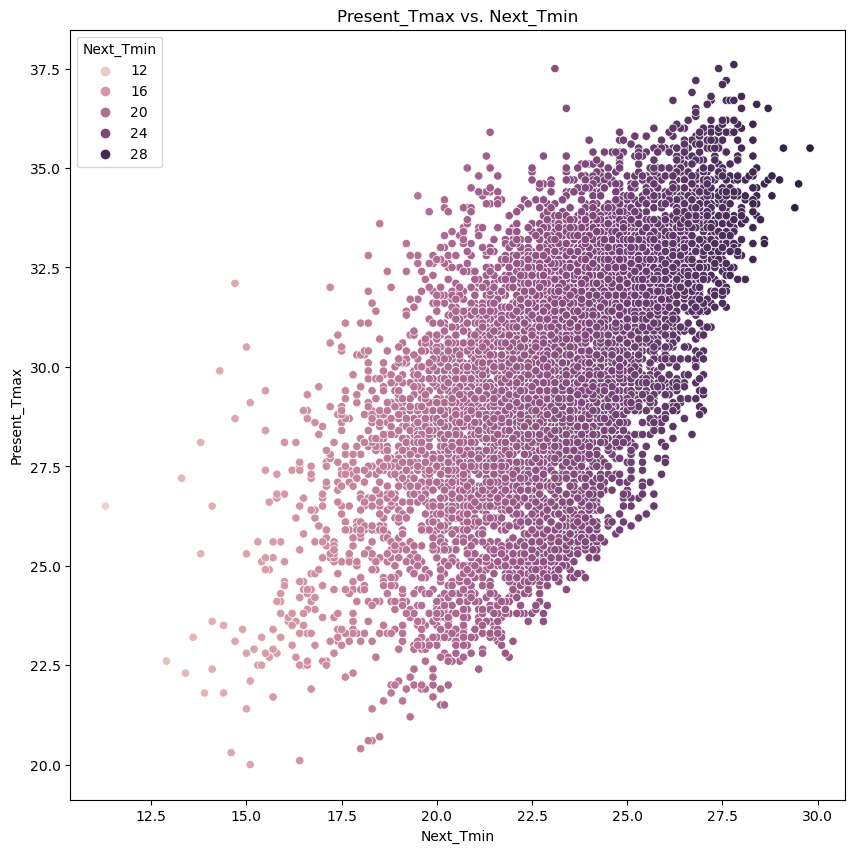

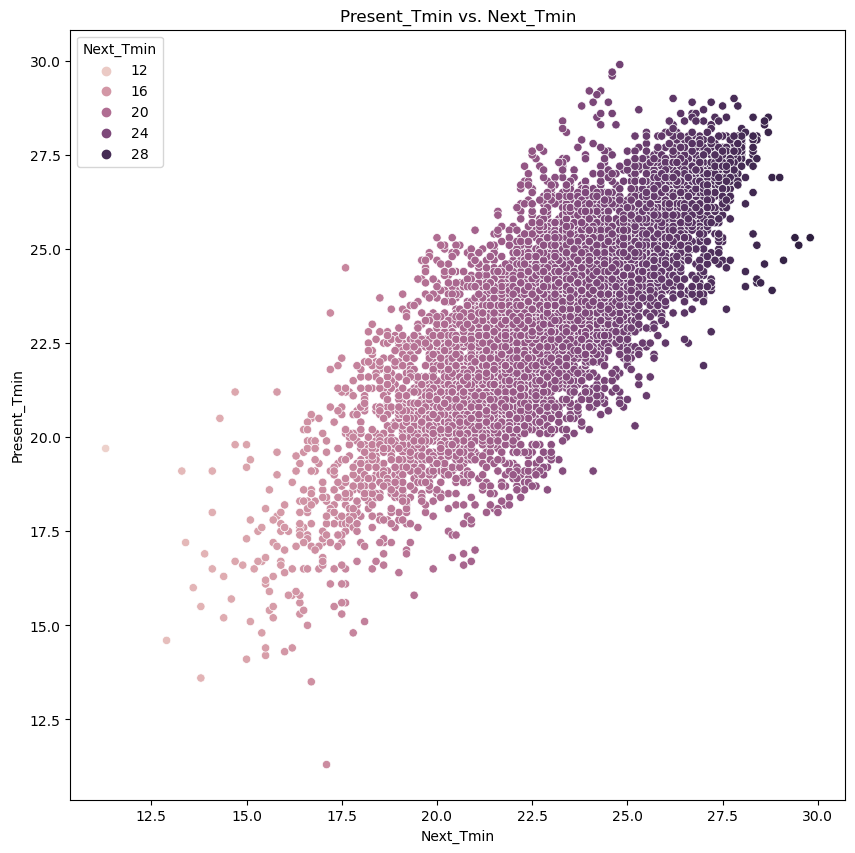

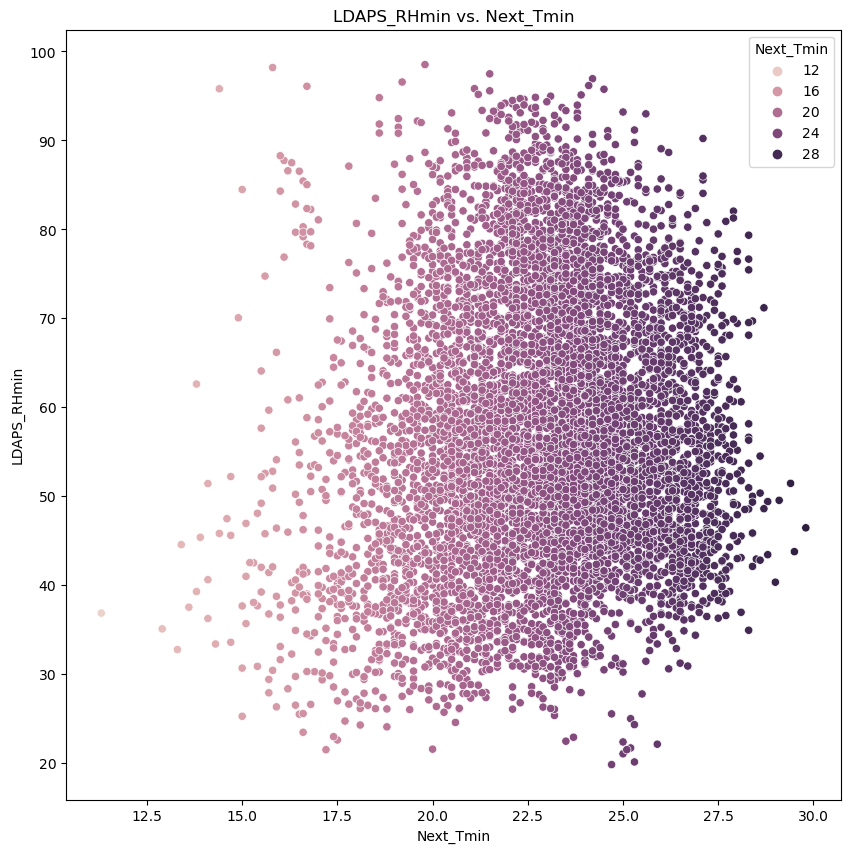

...

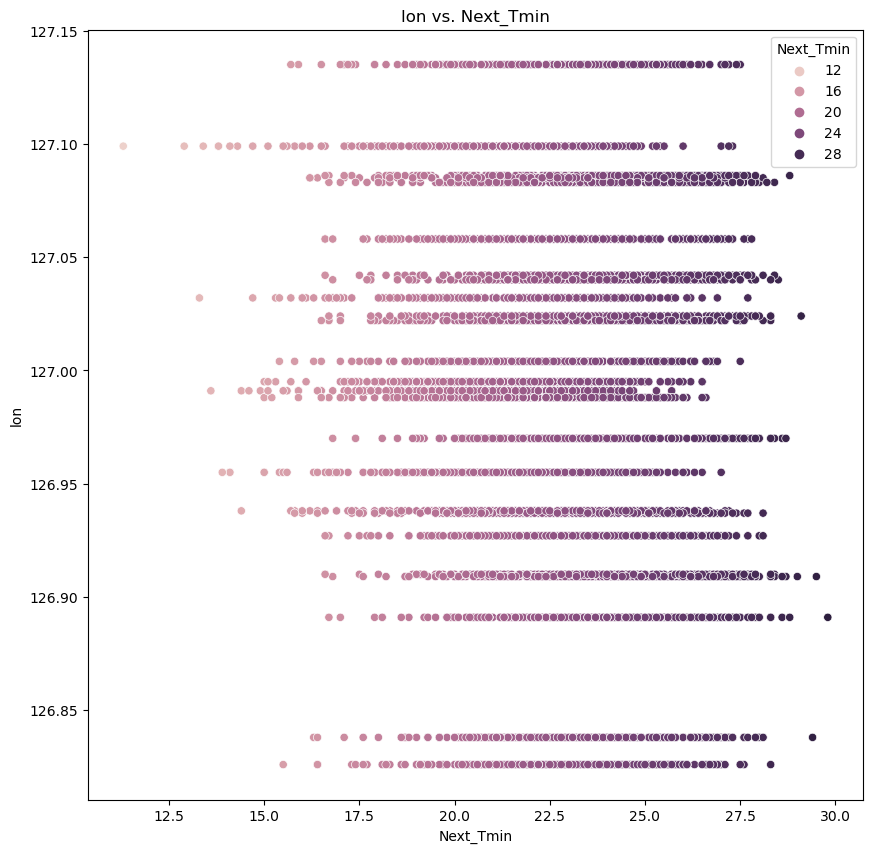

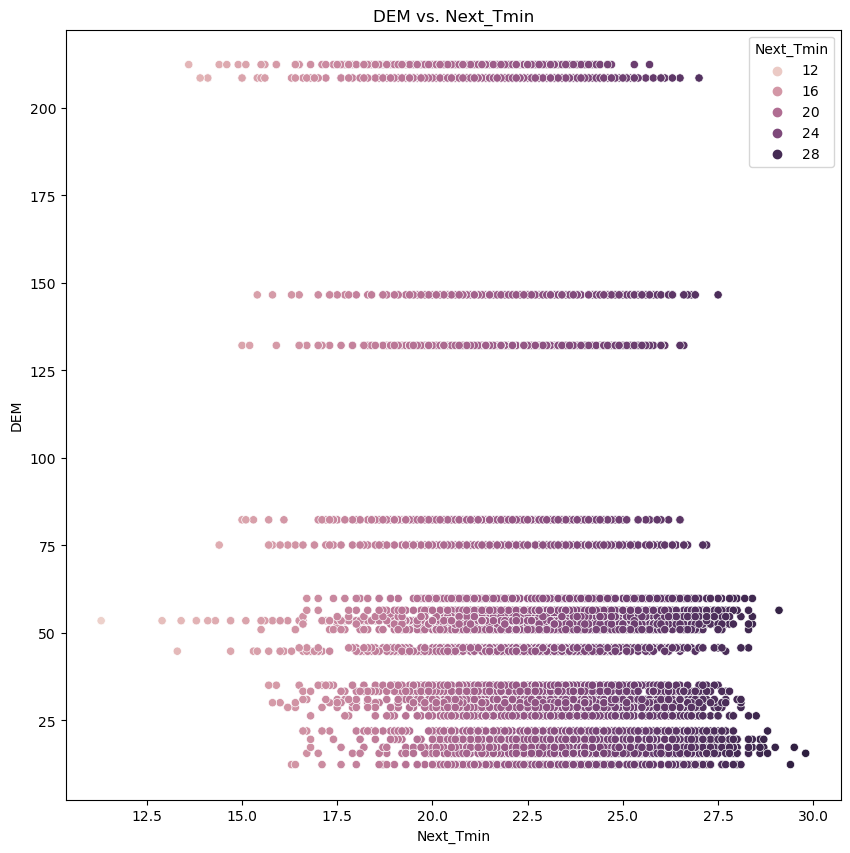

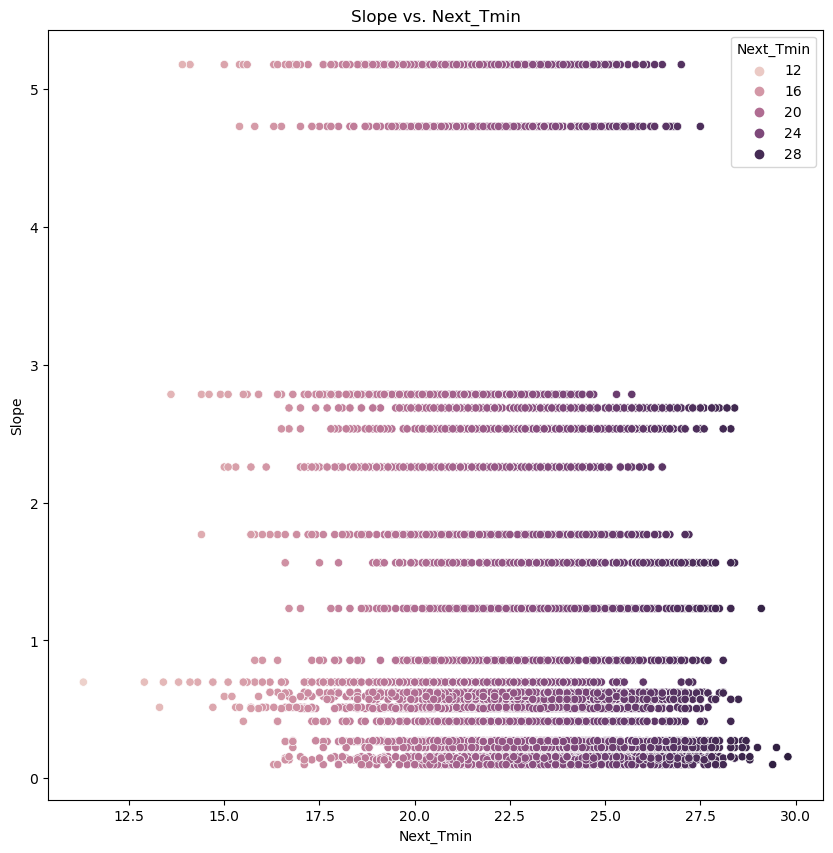

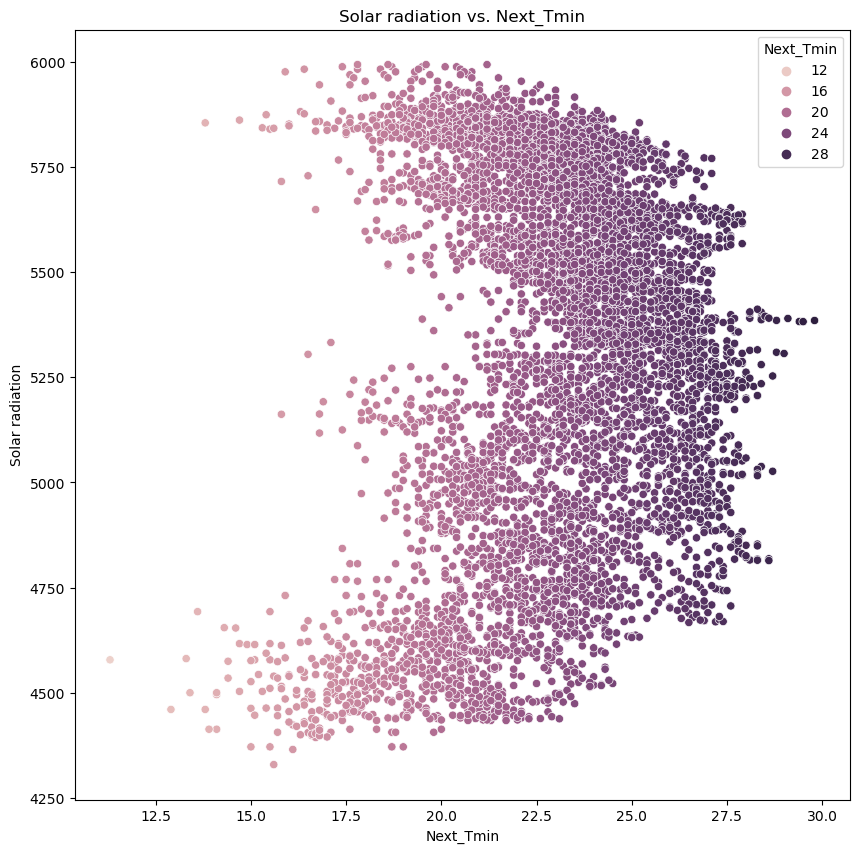

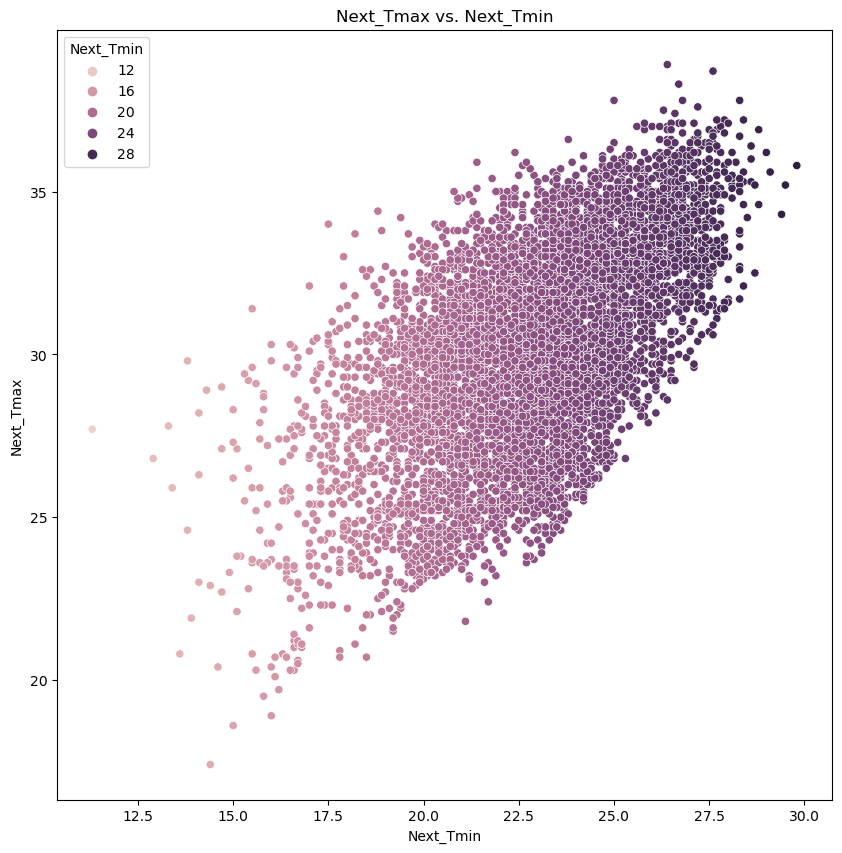

In [70]:
for col in df.drop(['Next_Tmin'],axis=1):
    plt.figure(figsize=(10,10))
    plt.title(f'{col} vs. Next_Tmin')
    sns.scatterplot(y=df[col],x=df['Next_Tmin'],hue=df['Next_Tmin'])
    plt.show()

I am not plotting the Multivariate analysis as it increasing the size of the file

In [204]:
df.skew()

station            -0.004178
Date                0.011103
Present_Tmax       -0.257069
Present_Tmin       -0.353822
LDAPS_RHmin         0.301396
LDAPS_RHmax        -0.845264
LDAPS_Tmax_lapse   -0.222349
LDAPS_Tmin_lapse   -0.574035
LDAPS_WS            1.553926
LDAPS_LH            0.662971
LDAPS_CC1           0.456716
LDAPS_CC2           0.473929
LDAPS_CC3           0.639649
LDAPS_CC4           0.663815
LDAPS_PPT1          5.305906
LDAPS_PPT2          5.710360
LDAPS_PPT3          6.356670
LDAPS_PPT4          6.681256
lat                 0.085377
lon                -0.289048
DEM                 1.721617
Slope               1.559050
Solar radiation    -0.524325
Next_Tmax          -0.334842
Next_Tmin          -0.393662
dtype: float64

We can see skewness in most of the columns from above so we remove them using power transform method

In [205]:
from sklearn.preprocessing import PowerTransformer
PT=PowerTransformer()
for i in df.columns:
    if abs(df.loc[:,i].skew())>0.5:
        df.loc[:,i]=PT.fit_transform(df.loc[:,i].values.reshape(-1,1))

In [206]:
df.skew()

station            -0.004178
Date                0.011103
Present_Tmax       -0.257069
Present_Tmin       -0.353822
LDAPS_RHmin         0.301396
LDAPS_RHmax        -0.120174
LDAPS_Tmax_lapse   -0.222349
LDAPS_Tmin_lapse   -0.021647
LDAPS_WS            0.005937
LDAPS_LH            0.028141
LDAPS_CC1           0.456716
LDAPS_CC2           0.473929
LDAPS_CC3           0.091156
LDAPS_CC4           0.129974
LDAPS_PPT1          1.451770
LDAPS_PPT2          1.637689
LDAPS_PPT3          1.814526
LDAPS_PPT4          2.041426
lat                 0.085377
lon                -0.289048
DEM                 0.039591
Slope               0.233968
Solar radiation    -0.182349
Next_Tmax          -0.334842
Next_Tmin          -0.393662
dtype: float64

It is clear that skewness ids removed from most of the columns and we are good to go checking outliers now

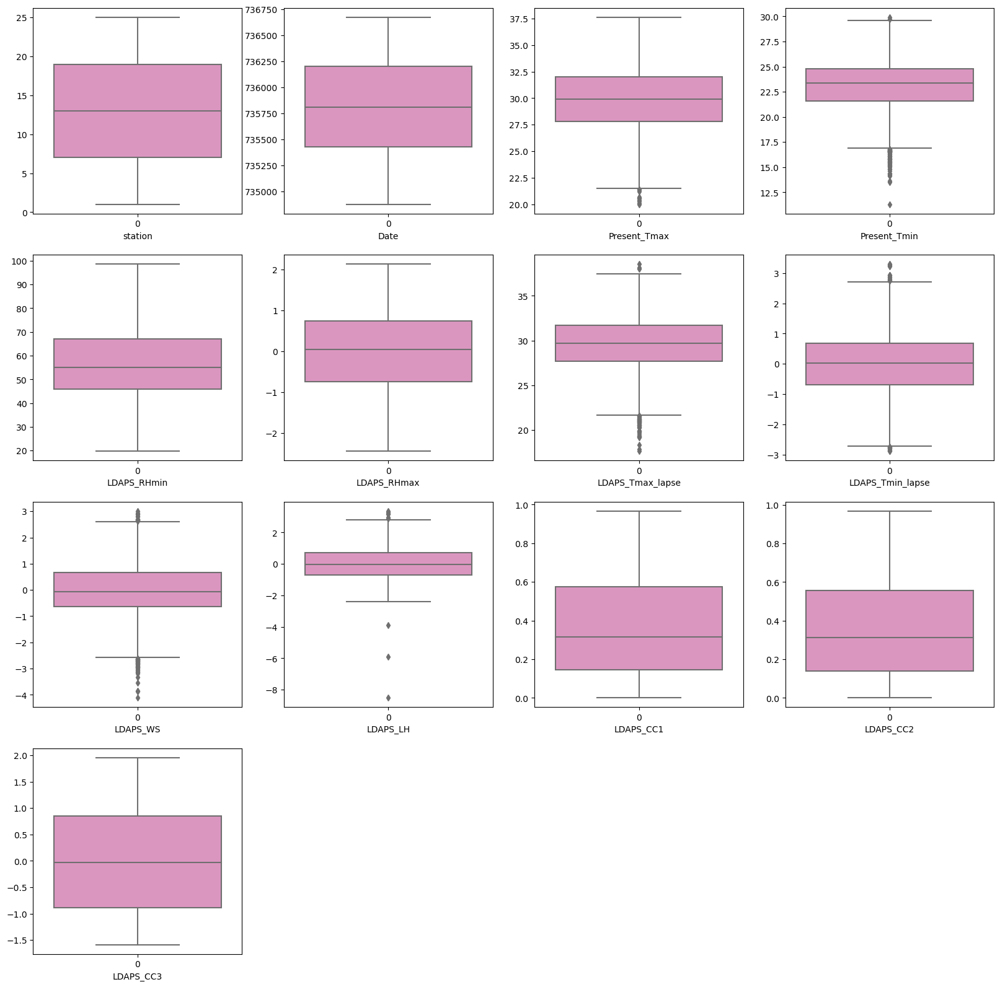

In [207]:
plt.figure(figsize=(20,25))
p=1
for i in df:
    if p<=13:
        plt.subplot(5,4,p)
        sns.boxplot(df[i],palette="Set2_r")
        plt.xlabel(i)
    p+=1
plt.show()

Most of the outliers are removed from skewness but still we can see outliers in Present_Tmax,Present_Tmin,LDAPS_WS,LDAPS_LH,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse so removing them

In [208]:
from scipy.stats import zscore
z=np.abs(zscore(df))
print(np.where(z>3))
df=df[(z<3).all(axis=1)]
df.shape

(array([1751, 2091, 2154, 2316, 2413, 2425, 2591, 2599, 2633, 2699, 2700,
       2708, 2733, 3123, 3141, 3147, 3148, 3148, 3166, 3172, 3173, 3223,
       3435, 3437, 3481, 3522, 4281, 4506, 4531, 4656, 4708, 4964, 4989,
       4989, 5014, 5379, 5675, 5949, 5959, 5967, 5972, 5973, 5982, 5983,
       5991, 5997, 5998, 6007, 6007, 6008, 6016, 6023, 6032, 6032, 6033,
       6035, 6041, 6048, 6048, 6050, 6051, 6057, 6057, 6057, 6057, 6058,
       6058, 6058, 6059, 6059, 6060, 6060, 6061, 6061, 6062, 6063, 6063,
       6065, 6065, 6066, 6066, 6066, 6067, 6068, 6068, 6068, 6069, 6069,
       6071, 6071, 6072, 6072, 6073, 6073, 6073, 6074, 6075, 6075, 6076,
       6076, 6077, 6117, 6140, 6957, 6970, 6971, 6979, 6980, 6981, 7450,
       7457, 7474, 7481, 7506, 7515, 7515, 7539, 7539, 7539, 7539, 7539,
       7540, 7547, 7549, 7553, 7554, 7556, 7557, 7557, 7563, 7563, 7563,
       7564, 7564, 7571, 7572, 7572, 7574, 7578, 7579, 7579, 7581, 7582],
      dtype=int64), array([ 9,  8,  8,  9,  8,  8

(7482, 25)

In [209]:
data_loss = (7588-7482)/7588*100
data_loss

1.39694254085398

In [210]:
cor=df.corr()
cor

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
station,1.000000,0.002264,0.105794,0.130321,-0.067506,-0.178037,0.062770,0.104714,0.023713,-0.130974,...,-0.006542,-0.010764,-0.002283,-0.241594,-0.122338,-0.320476,-0.141193,-0.027895,0.100908,0.125809
Date,0.002264,1.000000,0.069287,0.058359,-0.008732,-0.155186,0.033382,0.034634,-0.128777,0.041425,...,-0.066968,-0.007888,0.001750,-0.000437,-0.005294,-0.007021,-0.005797,-0.041086,0.073474,0.042088
Present_Tmax,0.105794,0.069287,1.000000,0.602123,-0.212245,-0.340621,0.559418,0.621792,-0.090075,0.133351,...,-0.152968,-0.100861,-0.096203,-0.047666,0.011233,-0.135703,-0.096188,-0.093601,0.597468,0.608379
Present_Tmin,0.130321,0.058359,0.602123,1.000000,0.128491,-0.039162,0.439987,0.756516,0.012034,-0.001956,...,0.080126,0.006052,-0.081912,-0.072694,-0.037318,-0.237315,-0.157872,-0.046963,0.437032,0.784164
LDAPS_RHmin,-0.067506,-0.008732,-0.212245,0.128491,1.000000,0.596279,-0.577503,0.073877,0.227896,-0.033751,...,0.577012,0.442290,0.294075,0.080238,-0.080542,0.066883,0.088999,0.235410,-0.449815,0.098050
LDAPS_RHmax,-0.178037,-0.155186,-0.340621,-0.039162,0.596279,1.000000,-0.411685,-0.179635,0.114412,0.255424,...,0.400167,0.259987,0.174571,0.228384,0.015340,0.185809,0.219041,0.162062,-0.326529,-0.104042
LDAPS_Tmax_lapse,0.062770,0.033382,0.559418,0.439987,-0.577503,-0.411685,1.000000,0.635863,-0.219795,0.024862,...,-0.406177,-0.326049,-0.262706,-0.032649,0.101635,-0.115295,-0.111564,-0.037867,0.826944,0.569820
LDAPS_Tmin_lapse,0.104714,0.034634,0.621792,0.756516,0.073877,-0.179635,0.635863,1.000000,-0.044183,-0.137431,...,-0.015896,-0.069471,-0.132815,-0.091784,-0.018049,-0.177527,-0.165894,0.012486,0.573247,0.876238
LDAPS_WS,0.023713,-0.128777,-0.090075,0.012034,0.227896,0.114412,-0.219795,-0.044183,1.000000,-0.032145,...,0.226996,0.142502,0.218931,0.003813,-0.068106,0.134965,0.119310,0.185527,-0.264948,-0.024730
LDAPS_LH,-0.130974,0.041425,0.133351,-0.001956,-0.033751,0.255424,0.024862,-0.137431,-0.032145,1.000000,...,-0.084735,0.005498,0.043402,0.111445,0.013821,0.040301,0.059202,-0.041041,0.150413,-0.051693


<Axes: >

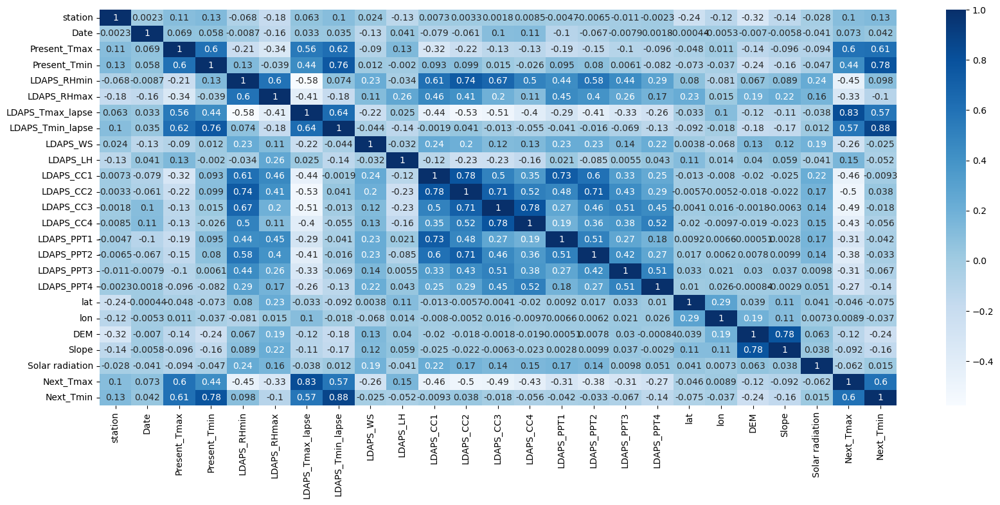

In [211]:
plt.figure(figsize=(20,8))
sns.heatmap(df.corr(),annot = True, cmap="Blues")

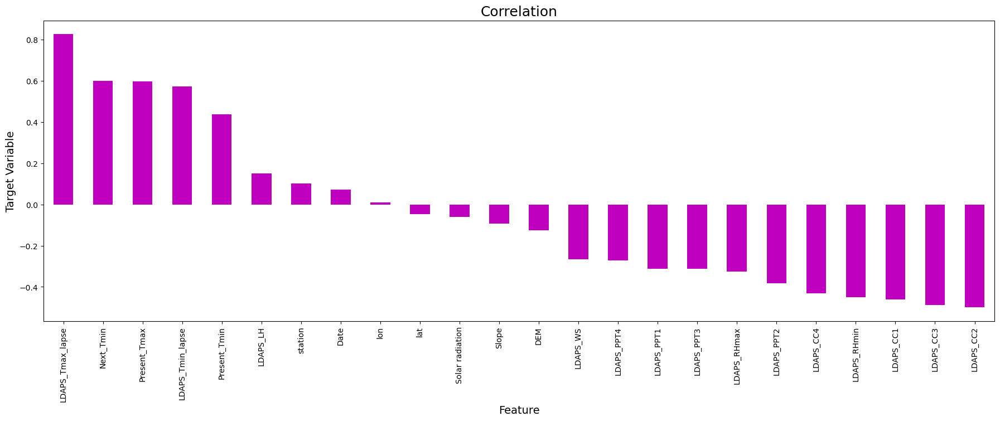

In [212]:
plt.figure(figsize=(22,7))
df.corr()['Next_Tmax'].sort_values(ascending=False).drop(['Next_Tmax']).plot(kind='bar',color='m')
plt.xlabel('Feature',fontsize=14)
plt.ylabel('Target Variable',fontsize=14)
plt.title('Correlation',fontsize=18)
plt.show()

It is clear from the above correlation that LDAPS_Tmax_lapse is positively correlated with the target(Next_Tmax) and LDAPS_CC2 is negatively correlated with the target(Next_Tmax) and column lat is very less correlated wit the target(Next_Tmax)

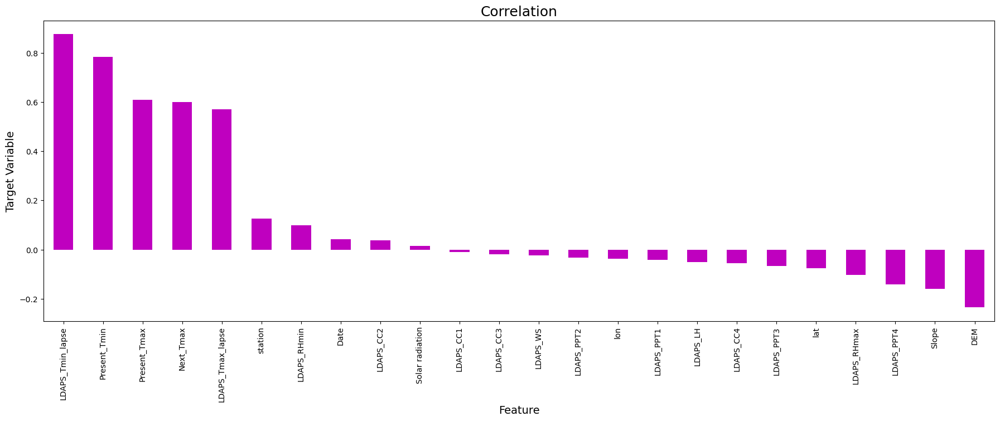

In [213]:
plt.figure(figsize=(22,7))
df.corr()['Next_Tmin'].sort_values(ascending=False).drop(['Next_Tmin']).plot(kind='bar',color='m')
plt.xlabel('Feature',fontsize=14)
plt.ylabel('Target Variable',fontsize=14)
plt.title('Correlation',fontsize=18)
plt.show()

It is clear from the above correlation that LDAPS_Tmin_lapse is positively correlated with the target(Next_Tmin) and DEM is negatively correlated with the target(Next_Tmin) and column LDAPS_CC1 is very less correlated wit the target(Next_Tmin)

In [214]:
y1 = df["Next_Tmax"]
y2 = df["Next_Tmin"]
x = df.drop(["Next_Tmax","Next_Tmin"],axis=1)

In [215]:
from sklearn.preprocessing import MinMaxScaler
SC=MinMaxScaler()
x=SC.fit_transform(x)
x

array([[0.        , 0.09688196, 0.45731707, ..., 1.        , 0.86679773,
        1.        ],
       [0.04166667, 0.09688196, 0.65243902, ..., 0.53433702, 0.33879126,
        0.87682847],
       [0.08333333, 0.09688196, 0.63414634, ..., 0.42424664, 0.1638077 ,
        0.87133124],
       ...,
       [0.91666667, 0.94432071, 0.12804878, ..., 0.10655541, 0.06102501,
        0.02252024],
       [0.95833333, 0.94432071, 0.12804878, ..., 0.15302217, 0.1254006 ,
        0.02092101],
       [1.        , 0.94432071, 0.12195122, ..., 0.20734605, 0.168189  ,
        0.02513477]])

Prediction with Next_Tmax

In [216]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error,mean_absolute_error
from sklearn.linear_model import LinearRegression
from sklearn.svm import SVR
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor,GradientBoostingRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.linear_model import Lasso,Ridge

from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RandomizedSearchCV

In [217]:
maxAccu=0
maxRS=0
for i in range (1,200):
    x_train,x_test,y1_train,y1_test=train_test_split(x,y1,test_size=0.20,random_state=i)
    LR=LinearRegression()
    LR.fit(x_train,y1_train)
    pred=LR.predict(x_test)
    acc=r2_score(y1_test,pred)
    if acc>maxAccu:
        maxAccu=acc
        maxRS=i
print("Best Accuracy is ",maxAccu,"on Random_state ",maxRS)

Best Accuracy is  0.7879481199621261 on Random_state  103


In [218]:
x_train,x_test,y1_train,y1_test=train_test_split(x,y1,test_size=0.20,random_state=maxRS)

In [219]:
RFR=RandomForestRegressor()
RFR.fit(x_train,y1_train)
pred_RFR=RFR.predict(x_test)
pred_train=RFR.predict(x_train)
print('R2_score for test data: ',r2_score(y1_test,pred_RFR))
print('R2_score on training data: ',r2_score(y1_train,pred_train)*100)
print('Mean Absolute Error: ',mean_absolute_error(y1_test,pred_RFR))
print('Mean Squared Error: ',mean_squared_error(y1_test,pred_RFR))
print('Root Mean Squared Error: ',np.sqrt(mean_squared_error(y1_test,pred_RFR)))

R2_score for test data:  0.9173875952270403
R2_score on training data:  98.69878246017196
Mean Absolute Error:  0.6721028724114895
Mean Squared Error:  0.7900832211088834
Root Mean Squared Error:  0.8888662560300529


In [220]:
LR=LinearRegression()
LR.fit(x_train,y1_train)
pred_LR=LR.predict(x_test)
pred_train=LR.predict(x_train)
print('R2_score for test data: ',r2_score(y1_test,pred_LR))
print('R2_score on training data: ',r2_score(y1_train,pred_train)*100)
print('Mean Absolute Error: ',mean_absolute_error(y1_test,pred_LR))
print('Mean Squared Error: ',mean_squared_error(y1_test,pred_LR))
print('Root Mean Squared Error: ',np.sqrt(mean_squared_error(y1_test,pred_LR)))

R2_score for test data:  0.7879481199621261
R2_score on training data:  75.8674566706423
Mean Absolute Error:  1.092273003789608
Mean Squared Error:  2.0280081772580933
Root Mean Squared Error:  1.4240815205802277


In [221]:
knn=KNeighborsRegressor()
knn.fit(x_train,y1_train)
pred_knn=knn.predict(x_test)
pred_train=knn.predict(x_train)
print('R2_score for test data: ',r2_score(y1_test,pred_knn))
print('R2_score on training data: ',r2_score(y1_train,pred_train)*100)
print('Mean Absolute Error: ',mean_absolute_error(y1_test,pred_knn))
print('Mean Squared Error: ',mean_squared_error(y1_test,pred_knn))
print('Root Mean Squared Error: ',np.sqrt(mean_squared_error(y1_test,pred_knn)))

R2_score for test data:  0.8178881672457398
R2_score on training data:  87.78660895969917
Mean Absolute Error:  0.9778223112892451
Mean Squared Error:  1.7416694722778892
Root Mean Squared Error:  1.3197232559434153


In [222]:
DTR=DecisionTreeRegressor()
DTR.fit(x_train,y1_train)
pred_DTR=DTR.predict(x_test)
pred_train=DTR.predict(x_train)
print('R2_score for test data: ',r2_score(y1_test,pred_DTR))
print('R2_score on training data: ',r2_score(y1_train,pred_train)*100)
print('Mean Absolute Error: ',mean_absolute_error(y1_test,pred_DTR))
print('Mean Squared Error: ',mean_squared_error(y1_test,pred_DTR))
print('Root Mean Squared Error: ',np.sqrt(mean_squared_error(y1_test,pred_DTR)))

R2_score for test data:  0.8160804590719675
R2_score on training data:  100.0
Mean Absolute Error:  0.9568470273881095
Mean Squared Error:  1.7589579158316633
Root Mean Squared Error:  1.3262571077402991


In [223]:
GBR=GradientBoostingRegressor()
GBR.fit(x_train,y1_train)
pred_GBR=GBR.predict(x_test)
pred_train=GBR.predict(x_train)
print('R2_score for test data: ',r2_score(y1_test,pred_GBR))
print('R2_score on training data: ',r2_score(y1_train,pred_train)*100)
print('Mean Absolute Error: ',mean_absolute_error(y1_test,pred_GBR))
print('Mean Squared Error: ',mean_squared_error(y1_test,pred_GBR))
print('Root Mean Squared Error: ',np.sqrt(mean_squared_error(y1_test,pred_GBR)))

R2_score for test data:  0.8650087246027441
R2_score on training data:  88.18517747360052
Mean Absolute Error:  0.8759357461092804
Mean Squared Error:  1.291020906370829
Root Mean Squared Error:  1.1362310092454038


In [224]:
RG=Ridge()
RG.fit(x_train,y1_train)
pred_RG=RG.predict(x_test)
pred_train=RG.predict(x_train)
print('R2_score for test data: ',r2_score(y1_test,pred_RG))
print('R2_score on training data: ',r2_score(y1_train,pred_train)*100)
print('Mean Absolute Error: ',mean_absolute_error(y1_test,pred_RG))
print('Mean Squared Error: ',mean_squared_error(y1_test,pred_RG))
print('Root Mean Squared Error: ',np.sqrt(mean_squared_error(y1_test,pred_RG)))

R2_score for test data:  0.7873891437360928
R2_score on training data:  75.85826163401124
Mean Absolute Error:  1.0925360441361285
Mean Squared Error:  2.0333540782568766
Root Mean Squared Error:  1.4259572497998938


In [225]:
score=cross_val_score(RFR,x,y1,cv=5)
print(score)
print(score.mean())
print("Difference between R2 score and cross validation score is: ",(r2_score(y1_test,pred_RFR)-score.mean()))

[0.72690671 0.6692236  0.64506652 0.78266792 0.58337321]
0.6814475922433638
Difference between R2 score and cross validation score is:  0.23594000298367646


In [226]:
score1=cross_val_score(LR,x,y1)
print(score1)
print(score1.mean())
print("Difference between R2 score and cross validation score is: ",(r2_score(y1_test,pred_LR)-score1.mean()))

[0.67340478 0.64296277 0.68267631 0.77505352 0.58040911]
0.6709012980037632
Difference between R2 score and cross validation score is:  0.11704682195836291


In [227]:
score2=cross_val_score(knn,x,y1)
print(score2)
print(score2.mean())
print("Difference between R2 score and cross validation score is: ",(r2_score(y1_test,pred_knn)-score2.mean()))

[0.51262975 0.31052231 0.38171021 0.52590403 0.43872346]
0.4338979532706144
Difference between R2 score and cross validation score is:  0.38399021397512534


In [228]:
score3=cross_val_score(DTR,x,y1)
print(score3)
print(score3.mean())
print("Difference between R2 score and cross validation score is: ",(r2_score(y1_test,pred_DTR)-score3.mean()))

[0.37759472 0.4457957  0.4524001  0.59755557 0.29504018]
0.43367725312100314
Difference between R2 score and cross validation score is:  0.38240320595096433


In [229]:
score4=cross_val_score(GBR,x,y1)
print(score4)
print(score4.mean())
print("Difference between R2 score and cross validation score is: ",(r2_score(y1_test,pred_GBR)-score4.mean()))

[0.74336693 0.70646611 0.6876966  0.81092997 0.64754877]
0.719201678114293
Difference between R2 score and cross validation score is:  0.1458070464884511


In [230]:
score5=cross_val_score(RG,x,y1)
print(score5)
print(score5.mean())
print("Difference between R2 score and cross validation score is: ",(r2_score(y1_test,pred_RG)-score5.mean()))

[0.67738802 0.6399626  0.68110283 0.77717391 0.58534702]
0.6721948763448857
Difference between R2 score and cross validation score is:  0.11519426739120708


I am selecting Ridge as the best working model as it has minimum difference between R2 score and cross validation score from the other models 

In [231]:
from sklearn.model_selection import GridSearchCV
param ={'max_iter' :[0,10,20],
              'random_state' :[15,16,17],
              'solver' : [ 'auto', 'svd','cholesky', 'lsqr', 'sparse_cg', 'sag', 'saga']}

In [232]:
GSCV=GridSearchCV(Ridge(),param,cv=3)

In [233]:
GSCV.fit(x_train,y1_train)

GridSearchCV(cv=3, estimator=Ridge(),
             param_grid={'max_iter': [0, 10, 20], 'random_state': [15, 16, 17],
                         'solver': ['auto', 'svd', 'cholesky', 'lsqr',
                                    'sparse_cg', 'sag', 'saga']})

In [234]:
GSCV.best_params_

{'max_iter': 10, 'random_state': 15, 'solver': 'sag'}

In [237]:
final =Ridge(max_iter=10, random_state=15, solver='sag')
Classifer=final.fit(x_train,y1_train)
lr_pred=final.predict(x_test)
lr_r2_score = r2_score(y1_test, lr_pred)
print(f"R2 score for the Final Model is:", lr_r2_score*100)

R2 score for the Final Model is: 78.82400538619


As we can see that the R2 score is increased from 78.73 to 78.82 saving our model which is ok.

In [118]:
import joblib
joblib.dump(final, "Temperature_Tmax.pkl")

['Temperature_Tmax.pkl']

In [120]:
model = joblib.load("Temperature_Tmax.pkl")
prediction=model.predict(x_test)
prediction

array([31.95638399, 32.0274114 , 29.45331561, ..., 33.16932605,
       32.73468395, 26.18291541])

In [121]:
a=np.array(y1_test)
df=pd.DataFrame()
df["Predicted"] = prediction
df["Original"] = a
df

,Predicted,Original
0,31.956384,33.8
1,32.027411,32.1
2,29.453316,30.0
3,32.630064,32.4
4,28.922391,28.2
...,...,...
1492,32.135135,33.8
1493,29.606260,28.6
1494,33.169326,33.7
1495,32.734684,33.6


In [123]:
conclusion=pd.DataFrame([final.predict(x_test)[:],y1_test[:]],index=["Predicted","Original"])
conclusion

,0,1,2,3,4,5,6,7,8,9,...,1487,1488,1489,1490,1491,1492,1493,1494,1495,1496
Predicted,31.956384,32.027411,29.453316,32.630064,28.922391,28.30137,29.969623,28.44426,29.721563,24.148629,...,27.419618,31.861006,31.348096,35.874135,30.643585,32.135135,29.60626,33.169326,32.734684,26.182915
Original,33.800000,32.100000,30.000000,32.400000,28.200000,27.00000,28.200000,29.10000,28.400000,24.000000,...,25.400000,33.200000,31.600000,35.500000,31.400000,33.800000,28.60000,33.700000,33.600000,25.500000


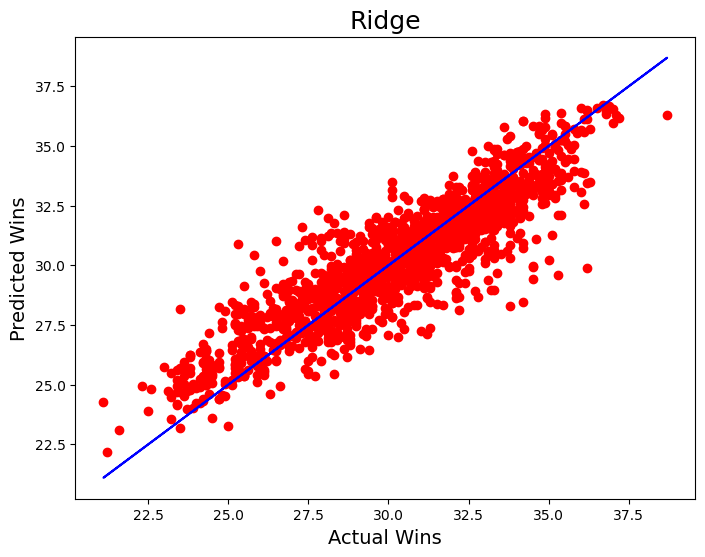

In [126]:
import matplotlib.pyplot as plt
plt.figure(figsize=(8,6))
plt.scatter(x=y1_test,y=pred_RG,color='r')
plt.plot(y1_test,y1_test,color='b')
plt.xlabel('Actual Wins',fontsize=14)
plt.ylabel('Predicted Wins',fontsize=14)
plt.title('Ridge',fontsize=18)
plt.savefig('RG.png')
plt.show()

Prediction for Next_Tmin

In [128]:
maxAccu=0
maxRS=0
for i in range (1,200):
    x_train,x_test,y2_train,y2_test=train_test_split(x,y2,test_size=0.30,random_state=i)
    LR=LinearRegression()
    LR.fit(x_train,y2_train)
    pred=LR.predict(x_test)
    acc=r2_score(y2_test,pred)
    if acc>maxAccu:
        maxAccu=acc
        maxRS=i
print("Best Accuracy is ",maxAccu,"on Random_state ",maxRS)

Best Accuracy is  0.8430122371352412 on Random_state  68


In [129]:
x_train,x_test,y2_train,y2_test=train_test_split(x,y2,test_size=0.30,random_state=maxRS)

In [131]:
LR=LinearRegression()
LR.fit(x_train,y2_train)
pred_LR=LR.predict(x_test)
pred_train=LR.predict(x_train)
print('R2_score for test data: ',r2_score(y2_test,pred_LR))
print('R2_score on training data: ',r2_score(y2_train,pred_train)*100)
print('Mean Absolute Error: ',mean_absolute_error(y2_test,pred_LR))
print('Mean Squared Error: ',mean_squared_error(y2_test,pred_LR))
print('Root Mean Squared Error: ',np.sqrt(mean_squared_error(y2_test,pred_LR)))

R2_score for test data:  0.8430122371352412
R2_score on training data:  81.72756028417973
Mean Absolute Error:  0.7547642229138767
Mean Squared Error:  0.918093826816251
Root Mean Squared Error:  0.9581721279687961


In [130]:
RFR=RandomForestRegressor()
RFR.fit(x_train,y2_train)
pred_RFR=RFR.predict(x_test)
pred_train=RFR.predict(x_train)
print('R2_score for test data: ',r2_score(y2_test,pred_RFR))
print('R2_score on training data: ',r2_score(y2_train,pred_train)*100)
print('Mean Absolute Error: ',mean_absolute_error(y2_test,pred_RFR))
print('Mean Squared Error: ',mean_squared_error(y2_test,pred_RFR))
print('Root Mean Squared Error: ',np.sqrt(mean_squared_error(y2_test,pred_RFR)))

R2_score for test data:  0.907845698000268
R2_score on training data:  98.60624256822818
Mean Absolute Error:  0.5672628062360803
Mean Squared Error:  0.5389356102449891
Root Mean Squared Error:  0.7341223401075526


In [132]:
knn=KNeighborsRegressor()
knn.fit(x_train,y2_train)
pred_knn=knn.predict(x_test)
pred_train=knn.predict(x_train)
print('R2_score for test data: ',r2_score(y2_test,pred_knn))
print('R2_score on training data: ',r2_score(y2_train,pred_train)*100)
print('Mean Absolute Error: ',mean_absolute_error(y2_test,pred_knn))
print('Mean Squared Error: ',mean_squared_error(y2_test,pred_knn))
print('Root Mean Squared Error: ',np.sqrt(mean_squared_error(y2_test,pred_knn)))

R2_score for test data:  0.8176804379234108
R2_score on training data:  87.98718960856978
Mean Absolute Error:  0.7920356347438753
Mean Squared Error:  1.0662389309576839
Root Mean Squared Error:  1.0325884615652472


In [134]:
DTR=DecisionTreeRegressor()
DTR.fit(x_train,y2_train)
pred_DTR=DTR.predict(x_test)
pred_train=DTR.predict(x_train)
print('R2_score for test data: ',r2_score(y2_test,pred_DTR))
print('R2_score on training data: ',r2_score(y2_train,pred_train)*100)
print('Mean Absolute Error: ',mean_absolute_error(y2_test,pred_DTR))
print('Mean Squared Error: ',mean_squared_error(y2_test,pred_DTR))
print('Root Mean Squared Error: ',np.sqrt(mean_squared_error(y2_test,pred_DTR)))

R2_score for test data:  0.8176804379234108
R2_score on training data:  100.0
Mean Absolute Error:  0.7920356347438753
Mean Squared Error:  1.0662389309576839
Root Mean Squared Error:  1.0325884615652472


In [135]:
GBR=GradientBoostingRegressor()
GBR.fit(x_train,y2_train)
pred_GBR=GBR.predict(x_test)
pred_train=GBR.predict(x_train)
print('R2_score for test data: ',r2_score(y2_test,pred_GBR))
print('R2_score on training data: ',r2_score(y2_train,pred_train)*100)
print('Mean Absolute Error: ',mean_absolute_error(y2_test,pred_GBR))
print('Mean Squared Error: ',mean_squared_error(y2_test,pred_GBR))
print('Root Mean Squared Error: ',np.sqrt(mean_squared_error(y2_test,pred_GBR)))

R2_score for test data:  0.8974662236737366
R2_score on training data:  90.13353084928917
Mean Absolute Error:  0.6104657045484746
Mean Squared Error:  0.5996367192415899
Root Mean Squared Error:  0.7743621370144527


In [136]:
RG=Ridge()
RG.fit(x_train,y2_train)
pred_RG=RG.predict(x_test)
pred_train=RG.predict(x_train)
print('R2_score for test data: ',r2_score(y2_test,pred_RG))
print('R2_score on training data: ',r2_score(y2_train,pred_train)*100)
print('Mean Absolute Error: ',mean_absolute_error(y2_test,pred_RG))
print('Mean Squared Error: ',mean_squared_error(y2_test,pred_RG))
print('Root Mean Squared Error: ',np.sqrt(mean_squared_error(y2_test,pred_RG)))

R2_score for test data:  0.8429020526349413
R2_score on training data:  81.72495455554127
Mean Absolute Error:  0.755302487029218
Mean Squared Error:  0.9187382064015777
Root Mean Squared Error:  0.958508323595355


In [137]:
score=cross_val_score(LR,x,y2)
print(score)
print(score.mean())
print("Difference between R2 score and cross validation score is: ",(r2_score(y2_test,pred_LR)-score.mean()))

[0.69755195 0.64583029 0.79091626 0.86207193 0.82922459]
0.7651190049949674
Difference between R2 score and cross validation score is:  0.07789323214027377


In [138]:
score1=cross_val_score(RFR,x,y2)
print(score1)
print(score1.mean())
print("Difference between R2 score and cross validation score is: ",(r2_score(y2_test,pred_RFR)-score1.mean()))

[0.47485489 0.66858541 0.81404602 0.86437562 0.84866753]
0.7341058962810625
Difference between R2 score and cross validation score is:  0.17373980171920556


In [140]:
score2=cross_val_score(knn,x,y2)
print(score2)
print(score2.mean())
print("Difference between R2 score and cross validation score is: ",(r2_score(y2_test,pred_knn)-score2.mean()))

[0.27439927 0.13999236 0.52206525 0.57520241 0.6119769 ]
0.4247272385688364
Difference between R2 score and cross validation score is:  0.39295319935457446


In [141]:
score3=cross_val_score(DTR,x,y2)
print(score3)
print(score3.mean())
print("Difference between R2 score and cross validation score is: ",(r2_score(y2_test,pred_DTR)-score3.mean()))

[0.01089618 0.45669777 0.65398964 0.75702265 0.67339229]
0.5103997037522504
Difference between R2 score and cross validation score is:  0.2658924990947027


In [142]:
score4=cross_val_score(GBR,x,y2)
print(score4)
print(score4.mean())
print("Difference between R2 score and cross validation score is: ",(r2_score(y2_test,pred_GBR)-score4.mean()))

[0.64555191 0.66913905 0.82204537 0.87188806 0.87704124]
0.77713312655186
Difference between R2 score and cross validation score is:  0.12033309712187668


In [143]:
score5=cross_val_score(RG,x,y2)
print(score5)
print(score5.mean())
print("Difference between R2 score and cross validation score is: ",(r2_score(y2_test,pred_RG)-score5.mean()))

[0.69900196 0.64650498 0.79072226 0.86186517 0.83048145]
0.765715164145963
Difference between R2 score and cross validation score is:  0.07718688848897837


I am selecting LinearRegression as the best working model as the difference between r2 score and cross validation score is minimum for this

In [144]:
from sklearn.model_selection import GridSearchCV

In [158]:
param ={'fit_intercept':[True], 'copy_X':[True], 'n_jobs':[None], 'positive':[False]}

In [159]:
GSCV=GridSearchCV(LinearRegression(),param,cv=4)

In [160]:
GSCV.fit(x_train,y2_train)

GridSearchCV(cv=4, estimator=LinearRegression(),
             param_grid={'copy_X': [True], 'fit_intercept': [True],
                         'n_jobs': [None], 'positive': [False]})

In [161]:
GSCV.best_params_

{'copy_X': True, 'fit_intercept': True, 'n_jobs': None, 'positive': False}

In [163]:
Final_model=LinearRegression(fit_intercept=True, copy_X=True, n_jobs=None, positive=False)
Classifer=Final_model.fit(x_train,y2_train)
lr_pred=Final_model.predict(x_test)
lr_r2_score = r2_score(y2_test, lr_pred)
print(f"R2 score for the Final Model is:", lr_r2_score*100)

R2 score for the Final Model is: 84.30122371352412


In [164]:
import joblib
joblib.dump(Final_model, "Temperature_Tmin.pkl")

['Temperature_Tmin.pkl']

In [165]:
model = joblib.load("Temperature_Tmin.pkl")
prediction=model.predict(x_test)
prediction

array([21.56741267, 20.51708709, 18.86656811, ..., 26.79854399,
       22.44525813, 21.96358618])

In [166]:
a=np.array(y2_test)
df=pd.DataFrame()
df["Predicted"] = prediction
df["Original"] = a
df

,Predicted,Original
0,21.567413,23.4
1,20.517087,20.1
2,18.866568,20.4
3,27.500607,27.5
4,22.572173,20.7
...,...,...
2240,25.526109,26.0
2241,17.552801,18.0
2242,26.798544,26.1
2243,22.445258,24.4


In [167]:
conclusion=pd.DataFrame([Final_model.predict(x_test)[:],y2_test[:]],index=["Predicted","Original"])
conclusion

,0,1,2,3,4,5,6,7,8,9,...,2235,2236,2237,2238,2239,2240,2241,2242,2243,2244
Predicted,21.567413,20.517087,18.866568,27.500607,22.572173,21.729458,19.639259,24.222159,21.572848,23.493679,...,19.649179,21.606094,24.201153,26.975099,21.778198,25.526109,17.552801,26.798544,22.445258,21.963586
Original,23.400000,20.100000,20.400000,27.500000,20.700000,20.200000,19.800000,24.700000,19.000000,24.200000,...,21.100000,21.100000,23.700000,27.000000,21.400000,26.000000,18.000000,26.100000,24.400000,24.000000


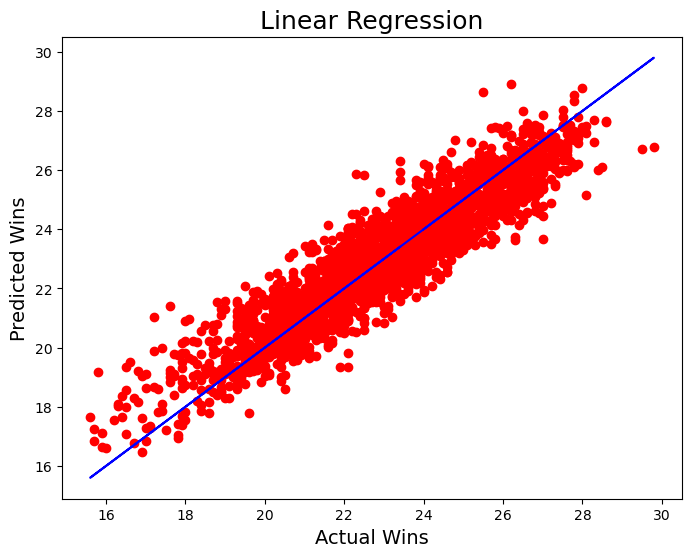

In [169]:
import matplotlib.pyplot as plt
plt.figure(figsize=(8,6))
plt.scatter(x=y2_test,y=pred_LR,color='r')
plt.plot(y2_test,y2_test,color='b')
plt.xlabel('Actual Wins',fontsize=14)
plt.ylabel('Predicted Wins',fontsize=14)
plt.title('Linear Regression',fontsize=18)
plt.savefig('LR.png')
plt.show()